In [1]:
import plot_functions
import compare_clusterings
import process_data
import visualizations

from compare_clusterings import *
from process_data import *
from plot_functions import *
from visualizations import *

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import mpl_toolkits.mplot3d.axes3d as p3
import matplotlib.animation as animation

In [3]:
import traj_generator
import physics_sim_simple_moreparticles_proteins

import process_data

In [4]:
import numpy as np
import plotly.graph_objs as go

In [5]:
move_groups_nr = 3
particles_per_group = 100

explicit_groups = []
group_size = 10

curr_group = 0
while 1 == 1:
    for i in range(group_size):
        explicit_groups.append(curr_group%move_groups_nr)

        if len(explicit_groups) == particles_per_group:
            break
    if len(explicit_groups) == particles_per_group:
        break
    curr_group = curr_group + 1


In [6]:
explicit_groups

[0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0]

In [7]:
sim_command = "physics_sim_simple_moreparticles_proteins.simulate_for_clustering(stim_steps=1000, temp=[1,2,3], thermostat=1, entities=1, particles_per_group=100, group_thermostat=0, dt=0.01, harmpot=0, fenepot=1, desireddist = 1.04, pot_const=30, group_additions=True, friction=1, explicit_groups=explicit_groups)"
particles_from_sim = eval(sim_command)

In [8]:
#particles_from_sim = physics_sim_simple_moreparticles_proteins.simulate_for_clustering(stim_steps=1000, temp=[1,2,3], thermostat=1, entities=1, particles_per_group=100, group_thermostat=1, dt=0.01, harmpot=0, fenepot=1, desireddist = 1.04, pot_const=30, group_additions=True, friction=1, explicit_groups=explicit_groups)

In [9]:
#particles_from_sim = physics_sim_simple_moreparticles_proteins.simulate_for_clustering(stim_steps=1000, temp=[1,2,3], thermostat=1, entities=1, particles_per_group=100, group_thermostat=0, dt=0.01, harmpot=0, fenepot=1, desireddist = 1.04, pot_const=30, group_additions=True, friction=1, explicit_groups=explicit_groups)

In [10]:
trajectories = process_data.simulation_to_array(particles_from_sim)

In [11]:
plot_functions.plot_traj_labels_plotly_2nd(trajectories)

In [12]:
groups_list = np.array(trajectories)[:,:,-1]
num_groups = len(np.unique(np.array(groups_list).flatten()))

In [13]:
num_groups

3

In [14]:
%matplotlib notebook


a = plot_functions.plot_traj_labels_plt(trajectories, save_video=False, interval = 10, title = sim_command + "\n Ground Truth", plt_fig_size=(10,7.5))

<IPython.core.display.Javascript object>

In [15]:
a

In [16]:
plt.show()

In [17]:
from IPython.display import HTML
HTML(a.to_html5_video())

In [18]:
df = process_data.create_clustering_df(trajectories)

In [19]:
import redpandda_general
res_hdbscan = redpandda_general.main_clustering_general(df, None, clustering_algorithm="hdbscan")

0.0301
something wrong with clustering Q computation


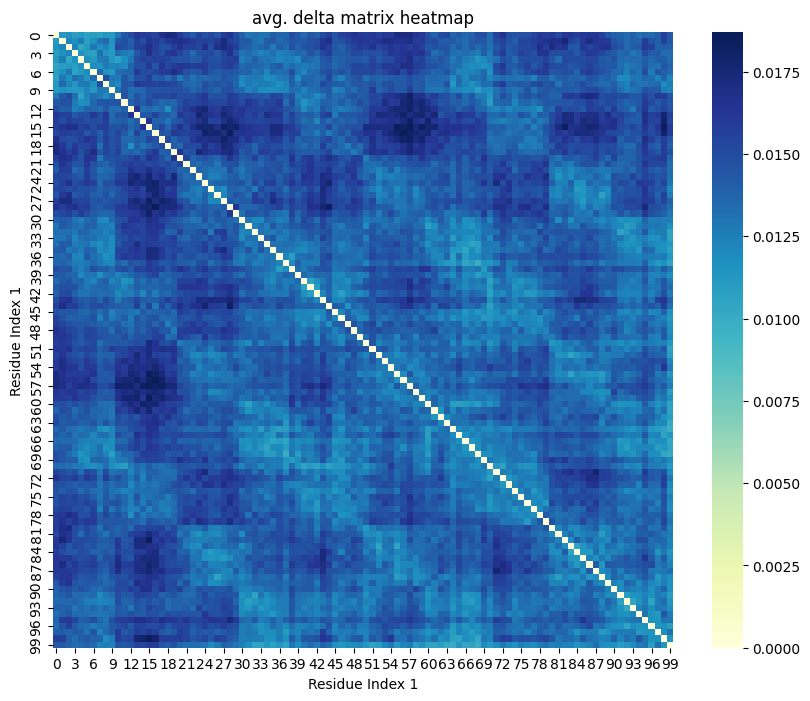

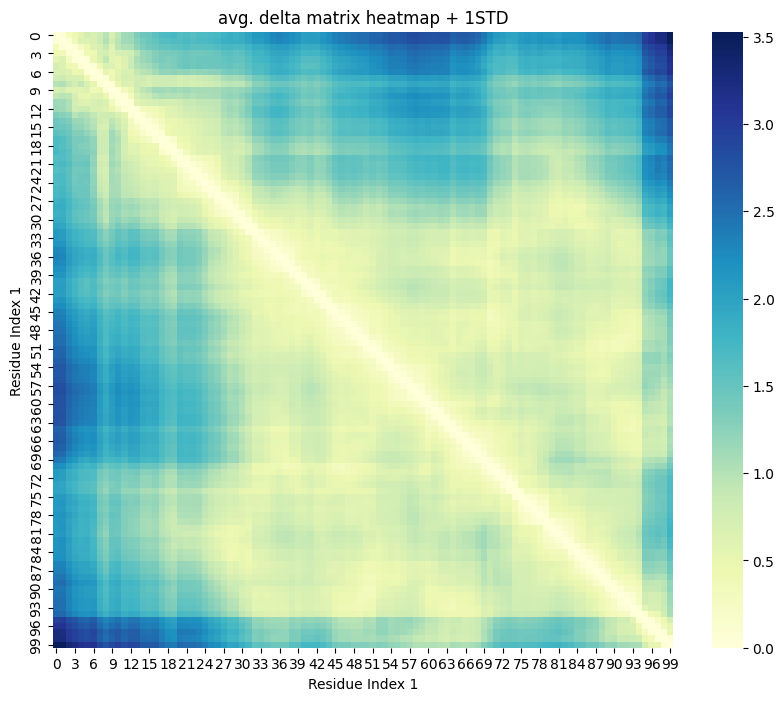

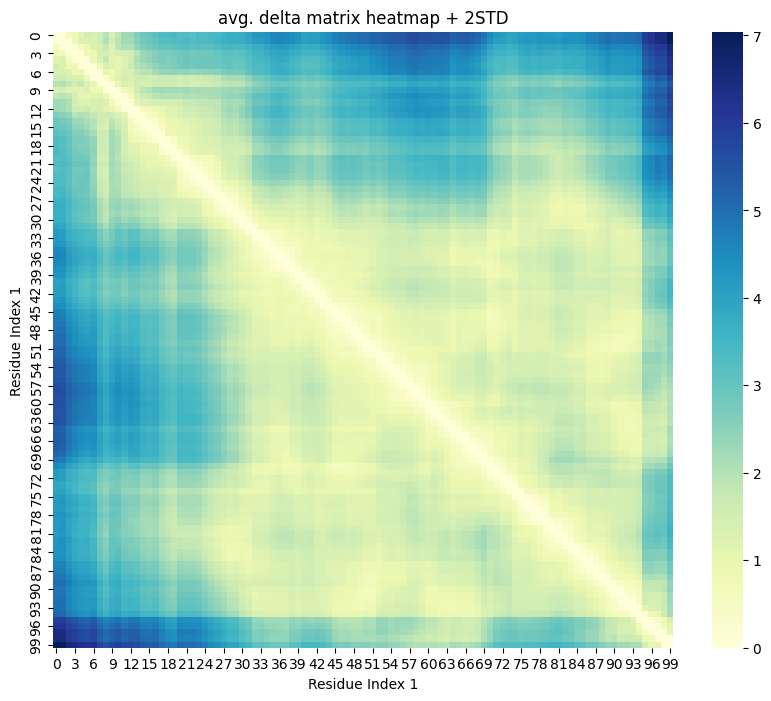

1.5822
something wrong with clustering Q computation


In [20]:
%matplotlib inline

res_hdbscan_2std = redpandda_general.main_clustering_general_std(df, None, clustering_algorithm="hdbscan")

In [21]:
res_hdbscan_2std

(array([-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1]),
 [],
 array([[1.        , 0.98897734, 0.90786601, ..., 0.08154958, 0.07714677,
         0.        ],
        [0.98897734, 1.        , 0.98769206, ..., 0.08744653, 0.07874591,
         0.00706544],
        [0.90786601, 0.98769206, 1.        , ..., 0.1413384 , 0.13728724,
         0.06227944],
        ...,
        [0.08154958, 0.08744653, 0.1413384 , ..., 1.        , 0.98766999,
         0.85823875],
        [0.07714677, 0.07874591, 0.13728724, ..., 0.98766999, 1.        ,
         0.98872581],
        [0.        , 0.00706544, 0.06227944, ..., 0.

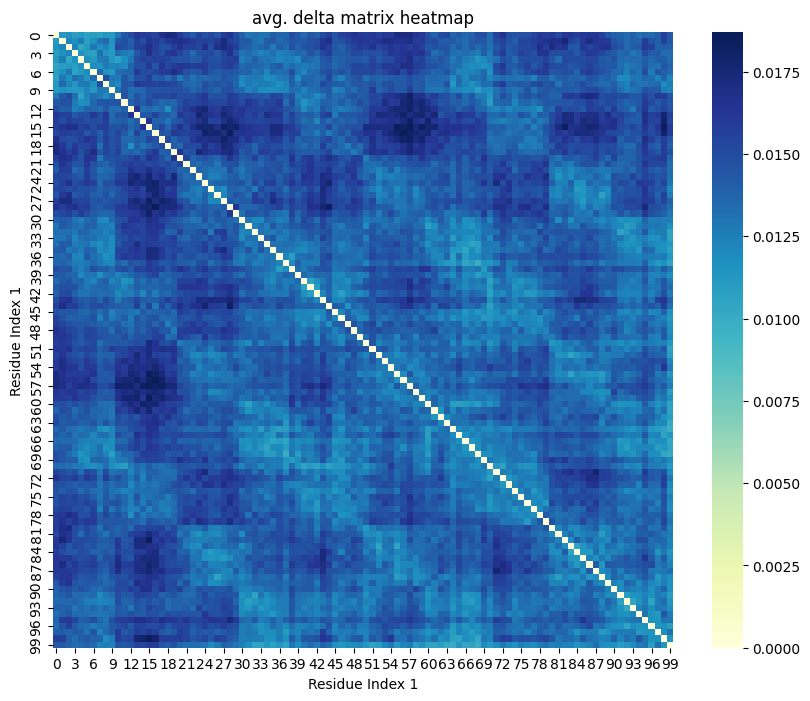

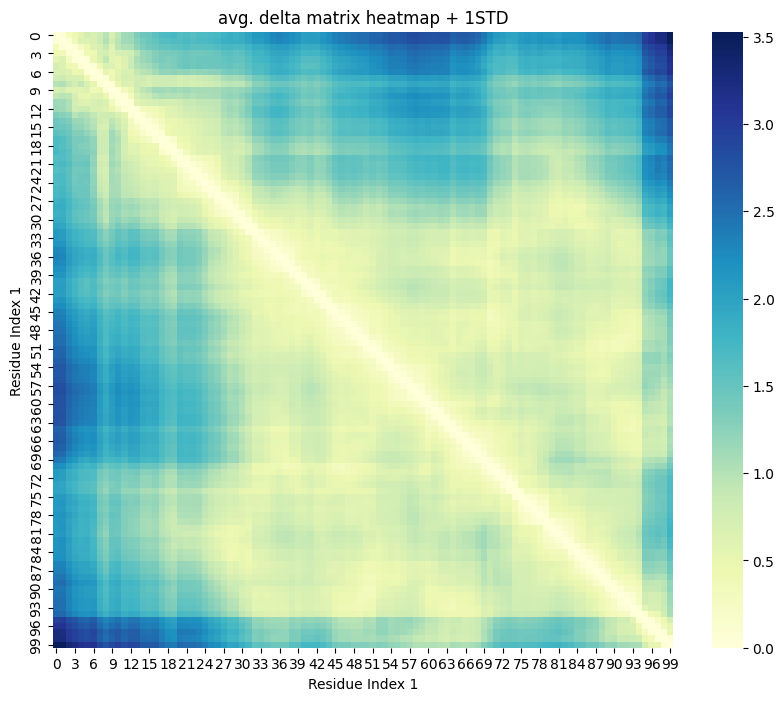

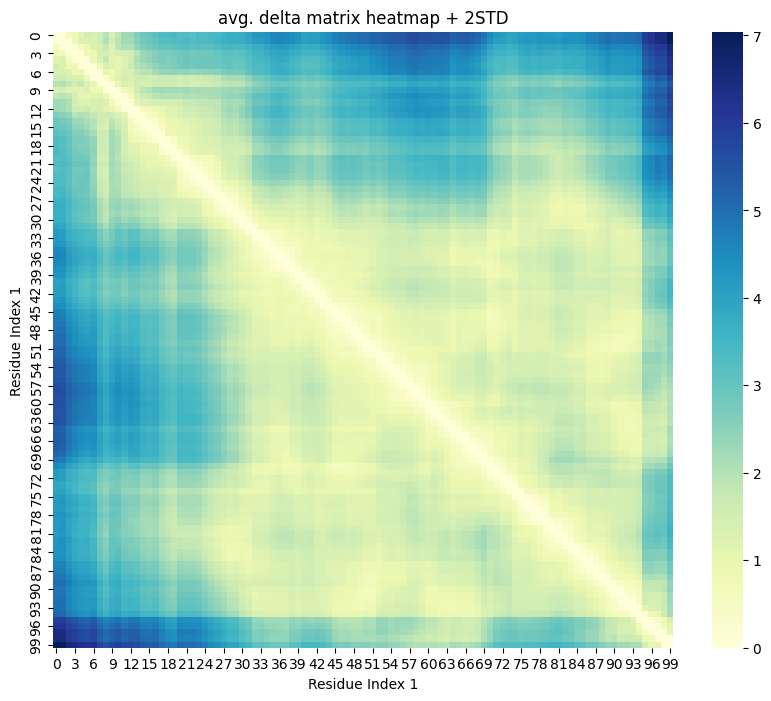

1.3997
something wrong with clustering Q computation


In [22]:
res_specvar = redpandda_general.main_clustering_general_std(df, None)

In [23]:
import redpandda_general
res_hdbscan = redpandda_general.main_clustering_general(df, None, clustering_algorithm="hdbscan")

0.0044
something wrong with clustering Q computation


In [24]:
res_hdbscan

(array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, -1, -1, -1, -1,
        -1,  0, -1, -1, -1,  0,  0,  0,  0,  0,  0,  0, -1,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  1,  0,  0,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0]),
 [],
 array([[0.99969817, 0.99987819, 0.99988554, ..., 0.99992478, 0.99995353,
         0.99992944],
        [0.99987819, 0.99969817, 0.99989508, ..., 0.99992499, 0.99995023,
         0.99992819],
        [0.99988554, 0.99989508, 0.99969817, ..., 0.99992151, 0.99992463,
         0.999923  ],
        ...,
        [0.99992478, 0.99992499, 0.99992151, ..., 0.99969817, 0.99988794,
         0.99991087],
        [0.99995353, 0.99995023, 0.99992463, ..., 0.99988794, 0.99969817,
         0.99988168],
        [0.99992944, 0.99992819, 0.999923  , ..., 0.

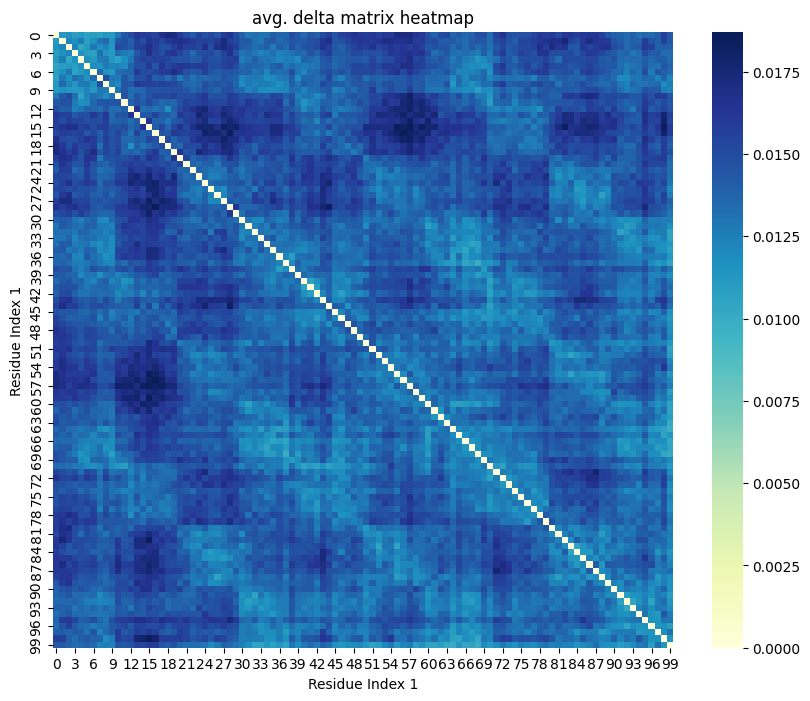

0.5210
something wrong with clustering Q computation


In [25]:
res = redpandda_general.main_clustering_general(df, 2)

In [26]:
res_hdbscan = redpandda_general.main_clustering_general(df, None, clustering_algorithm="hdbscan", min_cluster_size=2, min_samples=1)

0.0076
something wrong with clustering Q computation


In [27]:
res_hdbscan

(array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, -1, -1, -1, -1,
        -1,  0, -1, -1, -1,  0,  0,  0,  0,  0,  0,  0, -1,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  1,  0,  0,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0]),
 [],
 array([[0.99969817, 0.99987819, 0.99988554, ..., 0.99992478, 0.99995353,
         0.99992944],
        [0.99987819, 0.99969817, 0.99989508, ..., 0.99992499, 0.99995023,
         0.99992819],
        [0.99988554, 0.99989508, 0.99969817, ..., 0.99992151, 0.99992463,
         0.999923  ],
        ...,
        [0.99992478, 0.99992499, 0.99992151, ..., 0.99969817, 0.99988794,
         0.99991087],
        [0.99995353, 0.99995023, 0.99992463, ..., 0.99988794, 0.99969817,
         0.99988168],
        [0.99992944, 0.99992819, 0.999923  , ..., 0.

In [28]:
res

(array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0]),
 [],
 [],
 [array([[ 0],
         [ 1],
         [ 2],
         [ 3],
         [ 4],
         [ 5],
         [ 6],
         [ 7],
         [ 8],
         [ 9],
         [10],
         [11],
         [12],
         [13],
         [14],
         [15],
         [16],
         [17],
         [18],
         [19],
         [20],
         [21],
         [22],
         [23],
         [24],
         [25],
         [26],
         [27],
         [28],
         [29],
         [30],
         [31],
         [32],
         [33],
         [34],
         [35],
         [36],
         [37],
         [38],
         [39],
         [40],
         [41],
         [42],
   

In [29]:
res_agglon = redpandda_general.main_clustering_general(df, None, clustering_algorithm="agglomerative")

something wrong with clustering Q computation


In [30]:
res_agglon

(array([90, 78, 97, 86, 96, 60, 93, 66, 63, 76, 89, 52, 67, 57, 64, 71, 99,
        91, 58, 83, 65, 61, 69, 28, 95, 81, 88, 80, 68, 85, 56, 87, 44, 84,
        94, 47, 41, 49, 50, 77, 46, 82, 42, 51, 70, 38, 34, 24, 98, 55, 75,
        92, 72, 48, 27, 45, 53, 33, 59, 73, 54, 35, 43, 40, 23, 22, 79, 31,
        39, 32, 16, 11, 74, 37, 13, 62, 36, 30, 15, 25, 21, 18, 26, 19, 17,
        12,  7, 29, 14,  6, 10,  5,  2, 20,  9,  8,  3,  4,  1,  0]),
 [],
 array([[0.        , 0.5964092 , 0.62078501, ..., 0.75077199, 0.84604932,
         0.76623019],
        [0.5964092 , 0.        , 0.65236764, ..., 0.75146509, 0.83509122,
         0.76209564],
        [0.62078501, 0.65236764, 0.        , ..., 0.73995345, 0.75030163,
         0.74489976],
        ...,
        [0.75077199, 0.75146509, 0.73995345, ..., 0.        , 0.62873963,
         0.70468425],
        [0.84604932, 0.83509122, 0.75030163, ..., 0.62873963, 0.        ,
         0.60799241],
        [0.76623019, 0.76209564, 0.74489976, ..., 0.

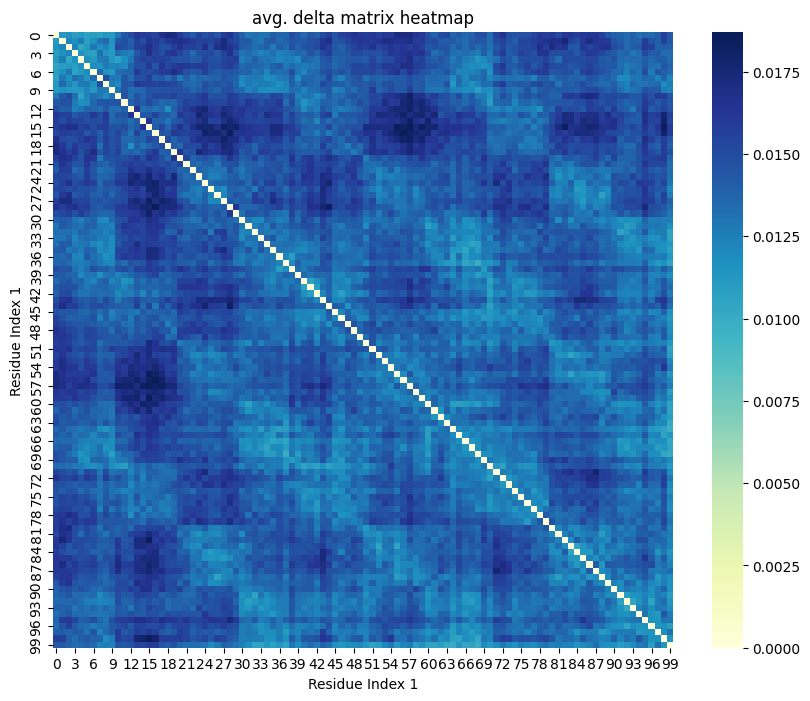

0.5479


In [31]:
res = redpandda_general.main_clustering_general(df, 6)

In [32]:
res_hdbscan = redpandda_general.main_clustering_general(df, None, clustering_algorithm="hdbscan")

0.0041
something wrong with clustering Q computation


In [33]:
res_hdbscan

(array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, -1, -1, -1, -1,
        -1,  0, -1, -1, -1,  0,  0,  0,  0,  0,  0,  0, -1,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  1,  0,  0,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0]),
 [],
 array([[0.99969817, 0.99987819, 0.99988554, ..., 0.99992478, 0.99995353,
         0.99992944],
        [0.99987819, 0.99969817, 0.99989508, ..., 0.99992499, 0.99995023,
         0.99992819],
        [0.99988554, 0.99989508, 0.99969817, ..., 0.99992151, 0.99992463,
         0.999923  ],
        ...,
        [0.99992478, 0.99992499, 0.99992151, ..., 0.99969817, 0.99988794,
         0.99991087],
        [0.99995353, 0.99995023, 0.99992463, ..., 0.99988794, 0.99969817,
         0.99988168],
        [0.99992944, 0.99992819, 0.999923  , ..., 0.

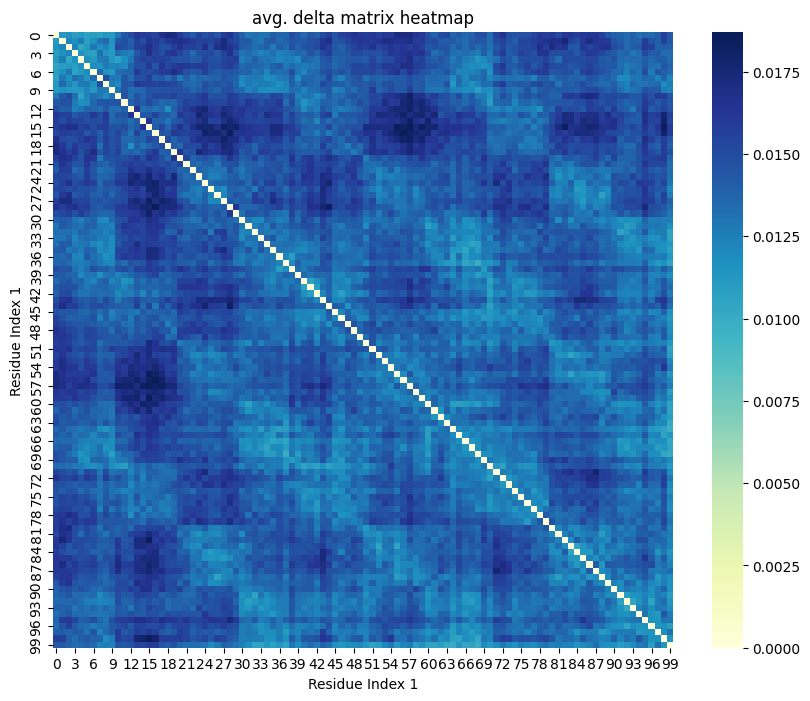

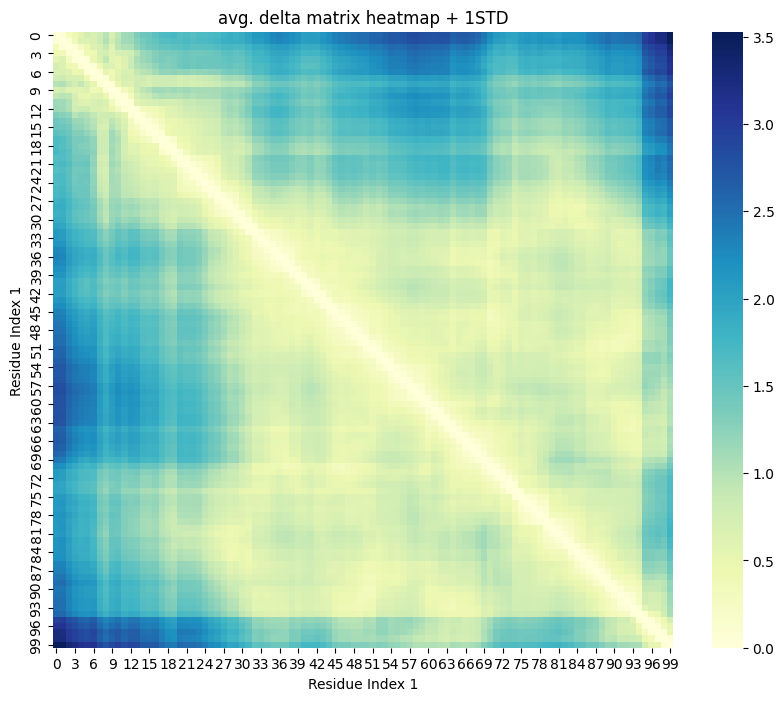

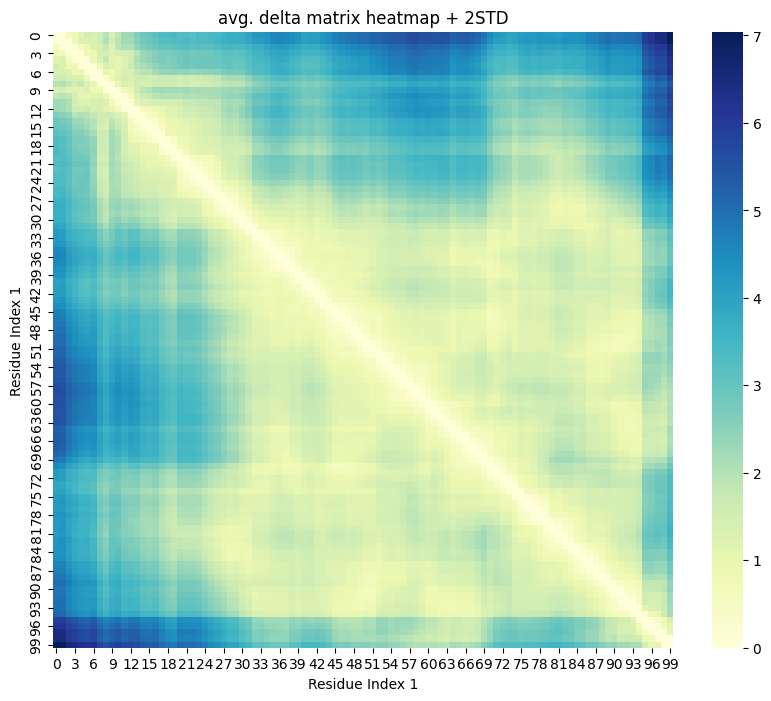

1.5443
something wrong with clustering Q computation


In [34]:
res_specvar = redpandda_general.main_clustering_general_std(df, None)

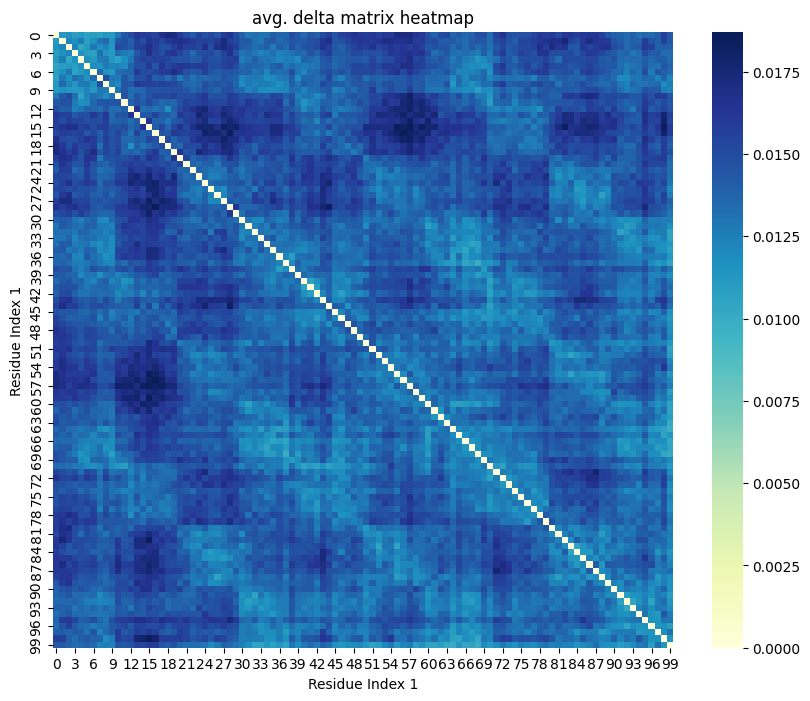

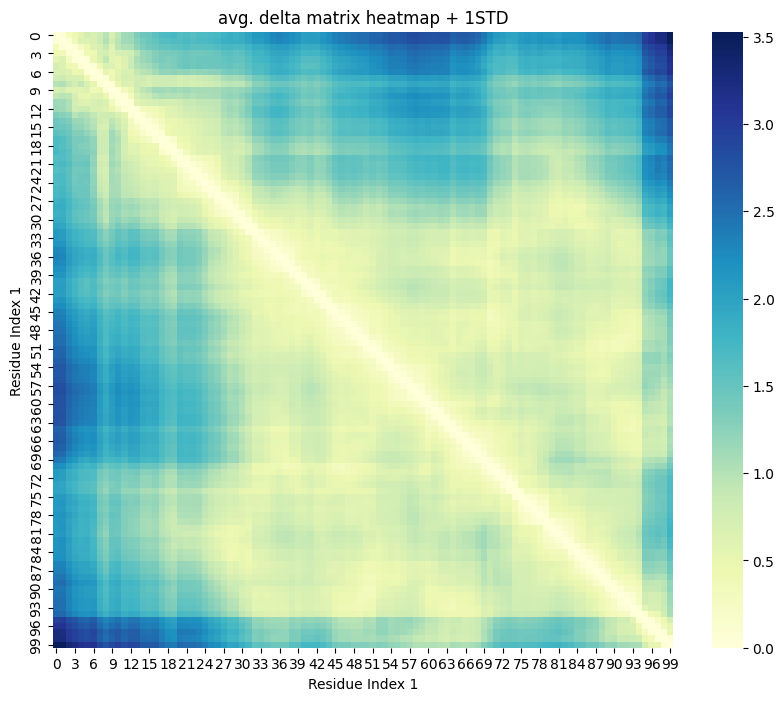

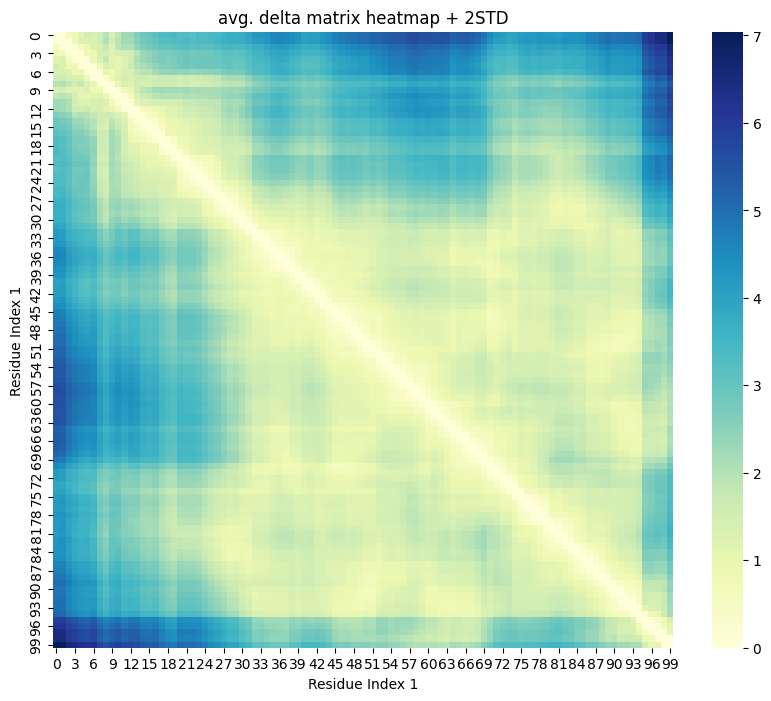

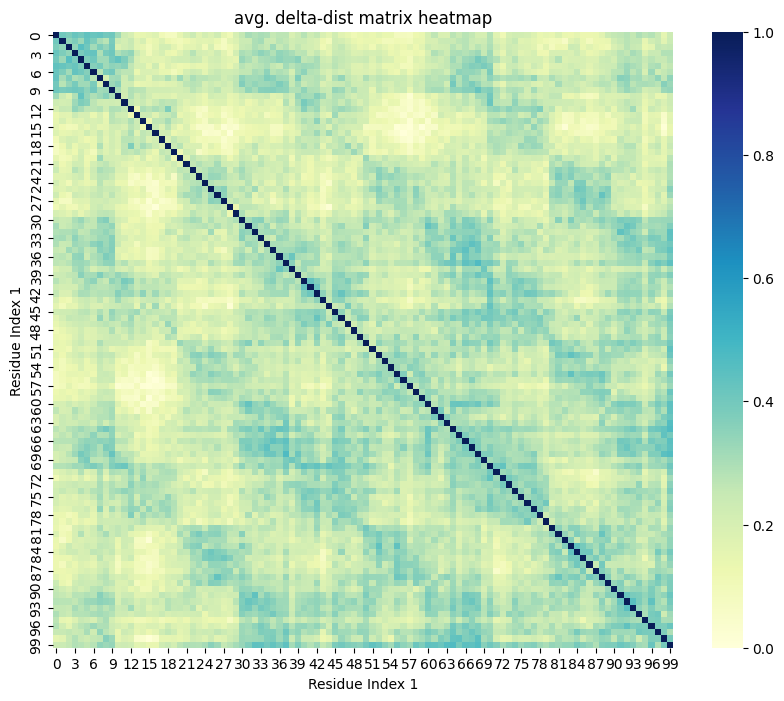

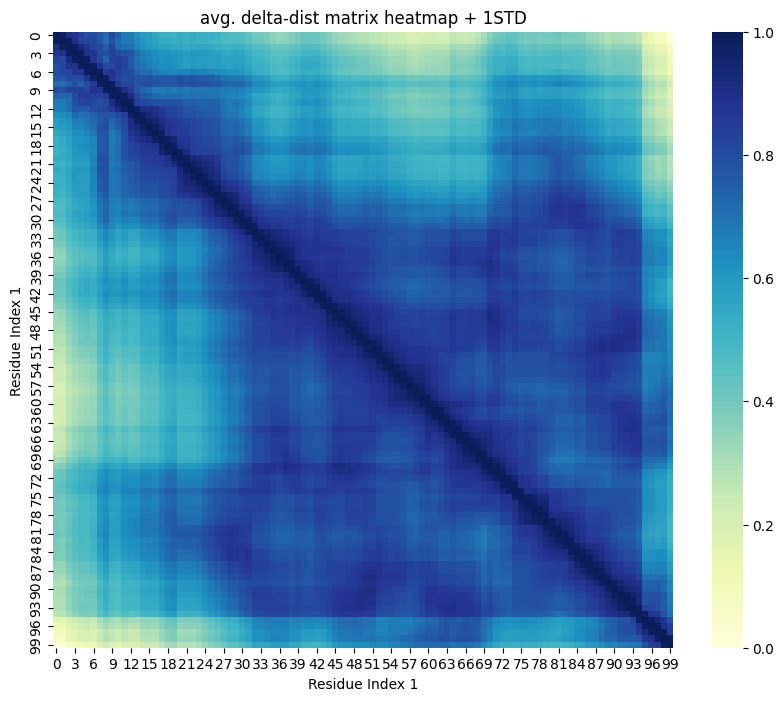

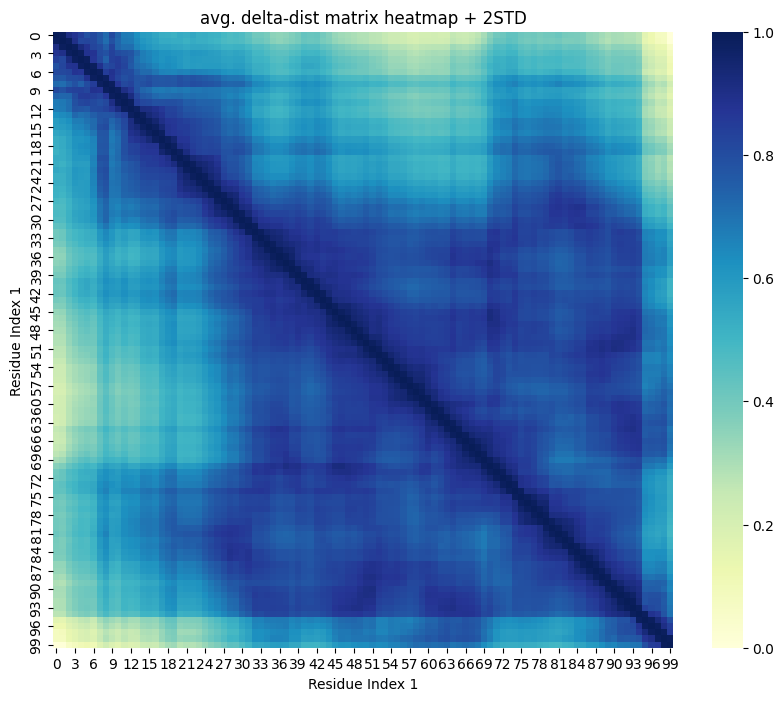

3.1575
something wrong with clustering Q computation


In [35]:
res_specvar_distance = redpandda_general.main_clustering_general_std_distance(df, None)

In [36]:
result_labels = res[0]

In [37]:
result_labels

array([3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 5, 5, 5, 5, 5, 5, 5, 5, 4, 4,
       4, 2, 4, 4, 4, 2, 4, 4, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 5, 5, 5, 5,
       2, 5, 0, 0, 0, 0, 1, 2, 2, 2, 2, 4, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1,
       1, 1, 0, 0, 0, 0, 0, 0, 5, 5, 5, 5, 5, 5, 2, 2, 2, 4, 4, 4, 4, 2,
       4, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0])

In [38]:
trajectories_results = []
for ip, particle_traj in enumerate(trajectories):
    trajectory_result = []

    for it, timestep in enumerate(particle_traj):
        trajectory_result.append([*timestep[:-1], result_labels[ip]])
    trajectories_results.append(trajectory_result)

In [39]:
trajectories_results = [
    [[*timestep[:-1], result_labels[ip]] for timestep in particle_traj]
    for ip, particle_traj in enumerate(trajectories)
]

In [40]:
traj_array, point_array, frames_count, n_objects = redpandda_general.prepare_data_from_df(df)

In [41]:
dist_matrices = redpandda_general.get_distance_matrices(traj_array)
delta_matrices = redpandda_general.get_delta_matrices(dist_matrices)
average_delta_matrix = redpandda_general.calculate_average_delta_matrix(delta_matrices)

std_delta_matrix = redpandda_general.get_std_matrices(dist_matrices)

In [42]:
std_delta_matrix

array([[0.        , 0.03323308, 0.3186298 , ..., 3.22719811, 3.2418104 ,
        3.51422155],
       [0.03323308, 0.        , 0.03723532, ..., 3.20642614, 3.23628175,
        3.48938006],
       [0.3186298 , 0.03723532, 0.        , ..., 3.01675943, 3.03092831,
        3.29511079],
       ...,
       [3.22719811, 3.20642614, 3.01675943, ..., 0.        , 0.03753417,
        0.49260162],
       [3.2418104 , 3.23628175, 3.03092831, ..., 0.03753417, 0.        ,
        0.03401039],
       [3.51422155, 3.48938006, 3.29511079, ..., 0.49260162, 0.03401039,
        0.        ]])

In [43]:
summed_delta_matrix = average_delta_matrix

In [44]:
summed_delta_matrix_1std = summed_delta_matrix + std_delta_matrix 
summed_delta_matrix_2std = summed_delta_matrix + std_delta_matrix * 2

In [45]:
from distance_matrix import *

In [46]:
normed_delta_matrix = 1 - normed_values(summed_delta_matrix)
normed_delta_matrix_1std = 1 - normed_values(summed_delta_matrix_1std)
normed_delta_matrix_2std = 1 - normed_values(summed_delta_matrix_2std)

In [47]:
normed_similarity_matrix = 1 - normed_values(summed_delta_matrix)
normed_similarity_matrix_1std = 1 - normed_values(summed_delta_matrix_1std)
normed_similarity_matrix_2std = 1 - normed_values(summed_delta_matrix_2std)

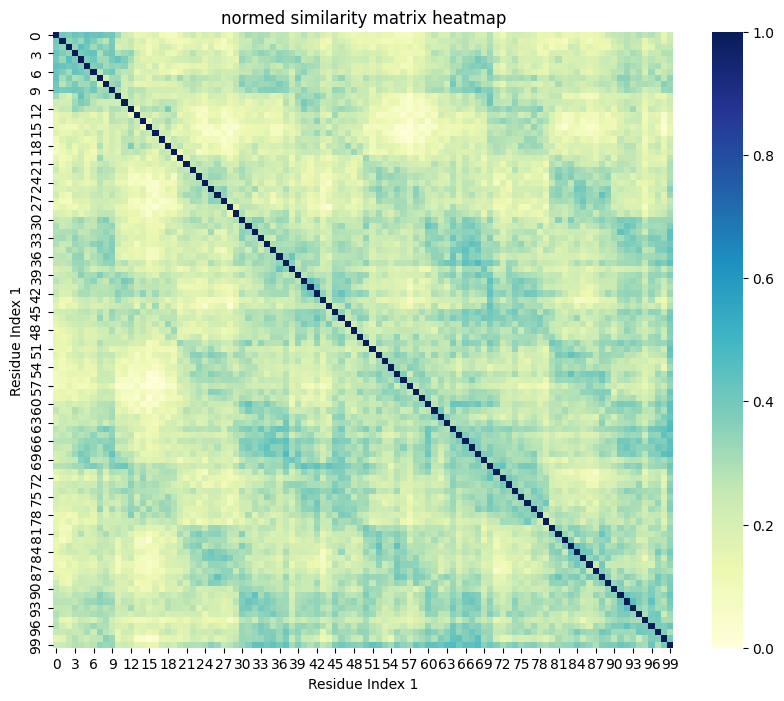

In [48]:
create_delta_heatmap(normed_similarity_matrix, title="normed similarity matrix heatmap")

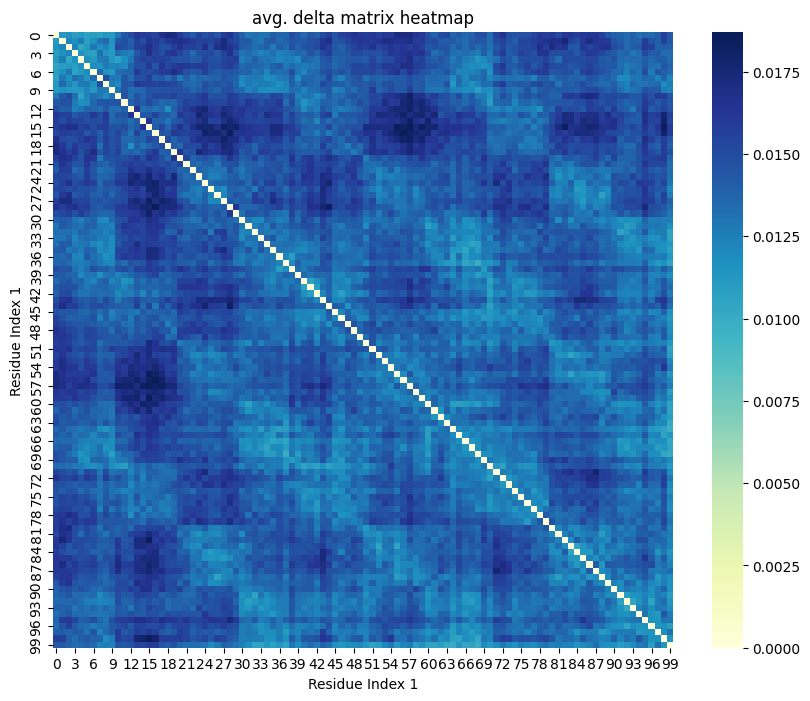

In [49]:
import distance_matrix
distance_matrix.create_delta_heatmap(average_delta_matrix, title="avg. delta matrix heatmap")

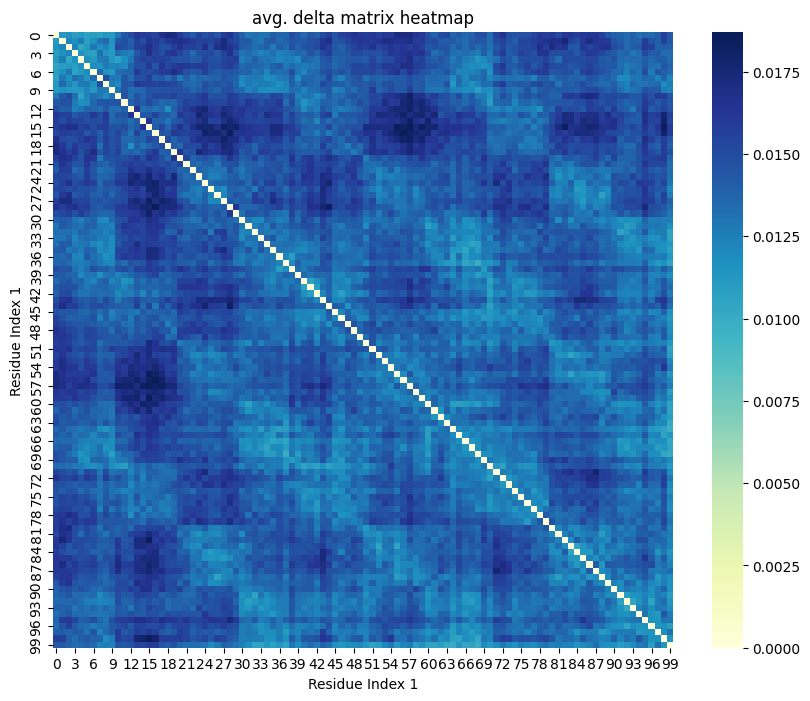

0.5357


array([4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2, 2, 3, 2, 2, 2, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 5, 5, 5, 5, 5, 5, 5, 0, 0, 0, 3, 3, 3, 3,
       3, 2, 0, 3, 2, 0, 5, 1, 1, 1, 1, 1, 0, 0, 0, 0, 5, 5, 5, 0, 5, 5,
       5, 0, 0, 0, 0, 0, 0, 0, 2, 3, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 3, 5, 5, 5, 5, 5, 5, 5, 5, 5, 0])

In [50]:
spectral_clustering_on_deltas(average_delta_matrix, 6)

In [51]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed')
result = clustering.fit(normed_similarity_matrix)

In [52]:
result.labels_

array([5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 1, 1, 0, 1, 1, 1, 0, 0, 0, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 3, 3, 3, 3, 3, 1, 1, 1, 1,
       1, 3, 3, 1, 3, 3, 4, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3,
       3, 3, 3, 3, 1, 3, 1, 1, 1, 1, 1, 1, 1, 0, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 4, 4, 4, 4, 4, 4, 4, 3, 3, 3], dtype=int32)

In [53]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed')
result = clustering.fit(summed_delta_matrix_2std)
print(result.labels_)

[1 1 0 1 0 1 0 1 0 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 0 1 0 0 1 4
 1 0 1 0 1 0 1 1 1 1 0 1 1 1 1 4 1 0 0 0 4 1 1 1 1 0 1 0 1 0 1 0 1 4 4 2 3
 2 3 2 1 1 0 4 1 1 1 1 1 4 4 4 1 4 4 4 4 5 1 1 1 1 4]


In [54]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=4, min_samples=2, metric='precomputed') 

result = clustering.fit(summed_delta_matrix.astype(np.float64))

print(result.labels_)

[ 0 -1 -1  0 -1  0  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1  2  2  2  2  2  2  2 -1 -1  1  1  1 -1 -1 -1 -1 -1
 -1 -1 -1 -1  3 -1 -1  3 -1 -1 -1 -1  2 -1 -1 -1  2  2  2  2  2 -1  1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  3 -1 -1 -1 -1  3 -1 -1  2  2 -1 -1 -1
  2 -1  2  2]


In [55]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=4, min_samples=2, metric='precomputed') 


result = clustering.fit(summed_delta_matrix_1std.astype(np.float64))

print(result.labels_)

[-1  1  1  1  1  1  1  1  1  1  1  1  1  1  2  2  2  2  2  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0 -1]


In [56]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result = clustering.fit(summed_delta_matrix_2std.astype(np.float64))

print(result.labels_)

[-1  3  3  3  3  3  3  4  4  4  4  4  2  2  1  1  1  1  1  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0 -1]


In [57]:
normed_delta_matrix = normed_values(summed_delta_matrix)
normed_delta_matrix_1std = normed_values(summed_delta_matrix_1std)
normed_delta_matrix_2std =  normed_values(summed_delta_matrix_2std)

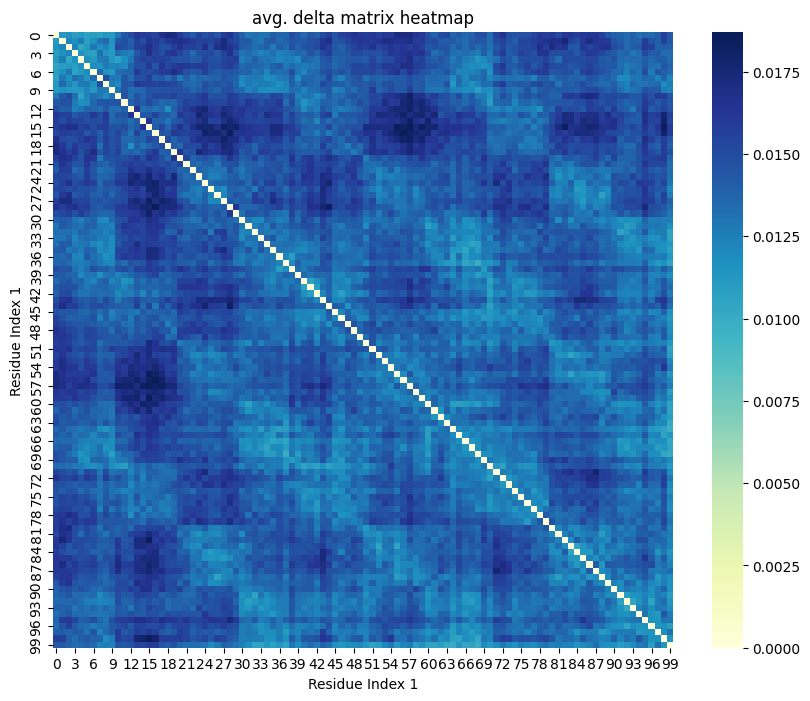

0.5817


array([3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 2, 4, 2, 4, 2, 2, 2, 1, 1,
       1, 0, 0, 0, 0, 0, 0, 0, 5, 5, 5, 5, 5, 5, 5, 0, 4, 4, 4, 4, 4, 4,
       4, 2, 4, 4, 2, 4, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 5, 5, 5, 0, 5, 5,
       5, 5, 5, 4, 4, 4, 4, 4, 4, 4, 2, 2, 4, 2, 1, 1, 1, 1, 0, 0, 0, 1,
       0, 1, 1, 1, 5, 5, 5, 5, 5, 5, 5, 5])

In [58]:
spectral_clustering_on_deltas(average_delta_matrix, 6)

In [59]:
clustering = AgglomerativeClustering(n_clusters=None, distance_threshold=0.1, affinity='precomputed', linkage='complete')

result = clustering.fit(average_delta_matrix)

In [60]:

clustering = AgglomerativeClustering(n_clusters=None, distance_threshold=0.7, metric='precomputed', linkage='complete')

result = clustering.fit(summed_delta_matrix_2std)

In [61]:
result.labels_

array([17, 17,  6,  6,  6, 20, 20, 29, 16, 16, 18, 18, 18,  2,  2,  2,  2,
       19, 19, 19, 14, 14, 14,  7,  7,  7, 11, 11, 11, 24, 24, 27, 27,  8,
        8,  8,  8,  8,  4,  4,  4,  4, 30, 30, 21, 21, 21, 21, 25, 25, 25,
        9,  9,  9,  9,  1,  1,  1,  1,  1,  1, 28, 28, 22, 22, 22,  5,  5,
        5,  5,  0,  0,  0,  0, 26, 26, 12, 12, 12, 12, 10, 10, 10, 10, 32,
       32, 13, 13, 13,  3,  3,  3,  3,  3, 15, 15, 23, 23, 31, 31])

In [62]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result = clustering.fit(summed_delta_matrix_2std.astype(np.float64))

print(result.labels_)

[-1  3  3  3  3  3  3  4  4  4  4  4  2  2  1  1  1  1  1  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0 -1]


In [63]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result = clustering.fit(summed_delta_matrix.astype(np.float64))

print(result.labels_)

[ 1 -1 -1  1 -1  1  1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1  3  3  3  3  3  3  3 -1 -1  2  2  2 -1 -1 -1  0 -1
 -1 -1 -1 -1  4 -1 -1  4 -1 -1 -1 -1  3 -1 -1 -1  3  3  3  3  3  0  2 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  4 -1 -1 -1 -1  4 -1 -1  3  3 -1 -1 -1
  3 -1  3  3]


In [64]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result = clustering.fit(normed_delta_matrix_2std.astype(np.float64))

print(result.labels_)

[-1  3  3  3  3  3  3  4  4  4  4  4  2  2  1  1  1  1  1  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0 -1]


In [65]:
#FF

In [66]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed')
result_spectral_6 = clustering.fit(normed_similarity_matrix)

clustering = SpectralClustering(n_clusters=3, affinity='precomputed')
result_spectral_3 = clustering.fit(normed_similarity_matrix)

In [67]:
clustering = SpectralClustering(n_clusters=4, affinity='precomputed')
result_spectral_4 = clustering.fit(normed_similarity_matrix)

In [68]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed', assign_labels="discretize")
result_spectral_6_discr = clustering.fit(normed_similarity_matrix)

In [69]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed', assign_labels="discretize")
result_spectral_6_discr = clustering.fit(normed_similarity_matrix)
result_spectral_6_discr.labels_

array([2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1,
       1, 4, 4, 4, 4, 4, 4, 5, 3, 3, 5, 3, 3, 5, 5, 5, 5, 5, 0, 0, 0, 0,
       0, 0, 0, 0, 5, 0, 3, 3, 4, 4, 4, 4, 4, 5, 4, 5, 5, 3, 5, 5, 5, 5,
       5, 5, 5, 5, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 4, 4, 4, 4, 1, 4, 1, 4,
       4, 4, 3, 3, 3, 3, 3, 3, 3, 5, 5, 5])

In [70]:
clustering = SpectralClustering(n_clusters=3, affinity='precomputed', assign_labels="discretize")
result_spectral_3_discr = clustering.fit(normed_similarity_matrix)
result_spectral_3_discr.labels_

array([2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1])

In [71]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed', assign_labels="cluster_qr")
result_spectral_6_discr = clustering.fit(normed_similarity_matrix)
result_spectral_6_discr.labels_

array([2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0,
       3, 3, 3, 3, 3, 3, 3, 1, 5, 5, 1, 5, 5, 4, 4, 4, 4, 4, 1, 1, 1, 1,
       1, 0, 4, 4, 0, 4, 5, 5, 3, 3, 3, 3, 3, 1, 4, 4, 5, 5, 1, 1, 1, 4,
       5, 4, 4, 4, 4, 4, 4, 4, 1, 1, 0, 0, 1, 0, 3, 3, 3, 3, 0, 3, 3, 3,
       3, 3, 5, 5, 5, 5, 5, 5, 5, 5, 1, 4])

In [72]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed')
result_spectral_6_discr = clustering.fit(normed_similarity_matrix)
result_spectral_6_discr.labels_

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 5, 1, 1, 1, 5, 5, 5, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 1, 1, 1, 1,
       1, 4, 4, 1, 4, 4, 2, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 2, 4, 4, 4, 4,
       4, 4, 4, 4, 1, 4, 1, 1, 1, 1, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4], dtype=int32)

In [73]:
result_spectral_3.labels_

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2], dtype=int32)

In [74]:
result_spectral_6.labels_

array([5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 1, 1, 0, 1, 1, 1, 0, 0, 0, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 3, 3, 2, 3, 3, 2, 2, 2, 2, 2, 1, 1, 1, 1,
       1, 2, 2, 1, 2, 2, 3, 3, 4, 4, 4, 4, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2,
       2, 2, 2, 2, 1, 2, 1, 1, 1, 1, 1, 1, 1, 0, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2], dtype=int32)

In [75]:
result_spectral_6_discr.labels_

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 5, 1, 1, 1, 5, 5, 5, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 1, 1, 1, 1,
       1, 4, 4, 1, 4, 4, 2, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 2, 4, 4, 4, 4,
       4, 4, 4, 4, 1, 4, 1, 1, 1, 1, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4], dtype=int32)

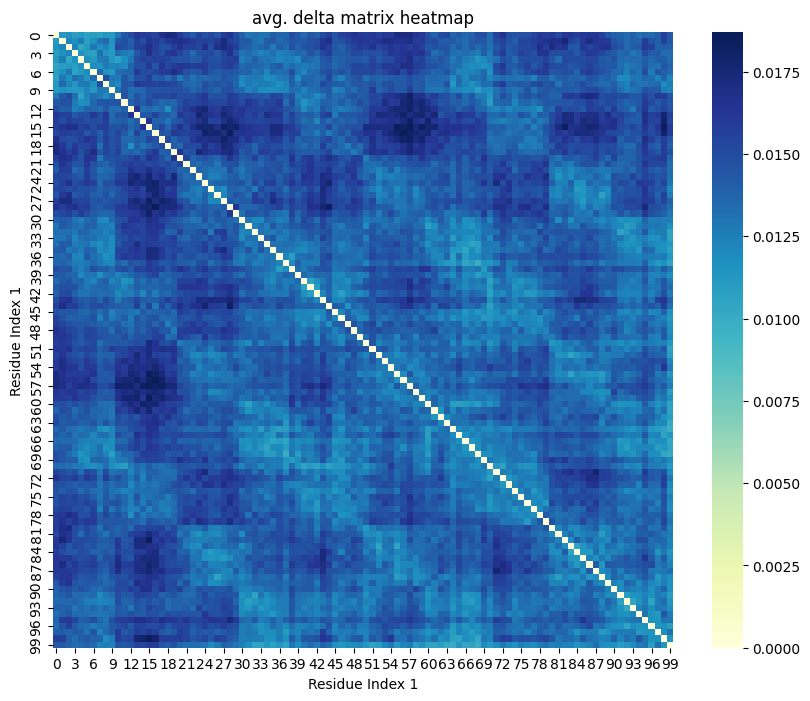

0.6261


array([4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2, 2, 0, 2, 2, 2, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1, 5, 5, 5, 0, 0, 0,
       0, 2, 5, 5, 2, 5, 0, 3, 3, 3, 3, 3, 3, 1, 5, 5, 1, 0, 1, 1, 1, 1,
       1, 1, 1, 5, 5, 5, 5, 5, 2, 0, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1])

In [76]:
distance_matrix.spectral_clustering_on_deltas(summed_delta_matrix, 6)

In [77]:
normed_similarity_matrix = 1 - normed_values(summed_delta_matrix)


In [78]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed')
result = clustering.fit(summed_delta_matrix_2std)
print(result.labels_)

[0 0 4 0 4 0 4 0 4 0 4 0 0 0 0 0 0 4 0 0 0 0 0 0 0 0 0 0 0 4 0 0 0 0 0 1 1
 1 4 1 4 1 4 0 4 0 0 0 0 0 0 0 4 4 0 4 4 4 4 0 0 0 0 0 4 0 0 0 0 0 4 2 1 2
 3 2 1 1 4 4 1 0 0 0 0 0 4 4 4 0 4 4 4 4 5 0 0 0 1 4]


In [79]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=4, min_samples=2, metric='precomputed') 

result_hdbscan_4_2 = clustering.fit(summed_delta_matrix.astype(np.float64))

print(result_hdbscan_4_2.labels_)

[ 0 -1 -1  0 -1  0  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1  2  2  2  2  2  2  2 -1 -1  1  1  1 -1 -1 -1 -1 -1
 -1 -1 -1 -1  3 -1 -1  3 -1 -1 -1 -1  2 -1 -1 -1  2  2  2  2  2 -1  1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  3 -1 -1 -1 -1  3 -1 -1  2  2 -1 -1 -1
  2 -1  2  2]


In [80]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=4, min_samples=2, metric='precomputed') 


result_hdbscan_4_2_1std = clustering.fit(summed_delta_matrix_1std.astype(np.float64))

print(result_hdbscan_4_2_1std.labels_)

[-1  1  1  1  1  1  1  1  1  1  1  1  1  1  2  2  2  2  2  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0 -1]


In [81]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result_hdbscan_2_2_2std = clustering.fit(summed_delta_matrix_2std.astype(np.float64))

print(result_hdbscan_2_2_2std.labels_)

[-1  3  3  3  3  3  3  4  4  4  4  4  2  2  1  1  1  1  1  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0 -1]


In [82]:
normed_delta_matrix = normed_values(summed_delta_matrix)
normed_delta_matrix_1std = normed_values(summed_delta_matrix_1std)
normed_delta_matrix_2std =  normed_values(summed_delta_matrix_2std)

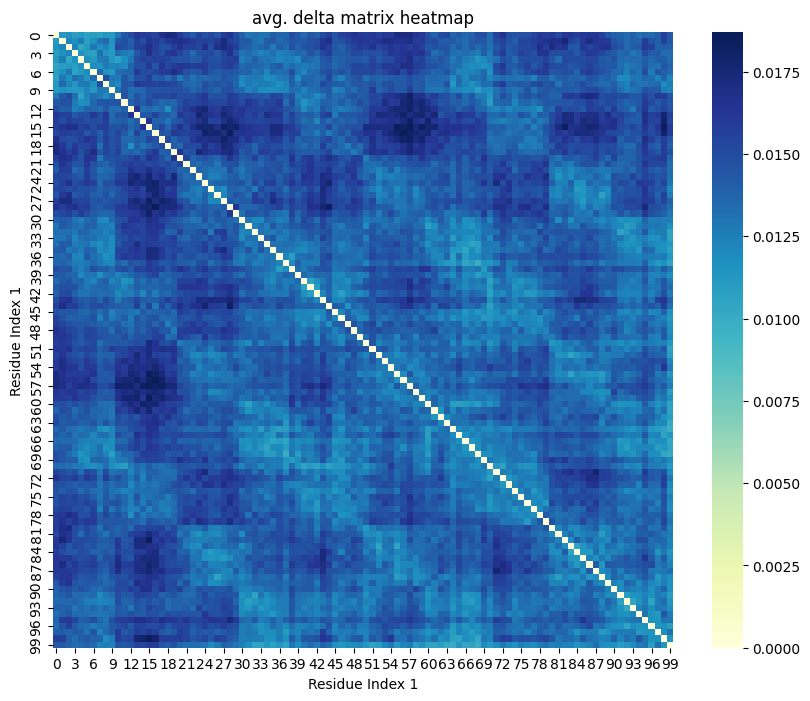

0.5917


array([3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 5, 5, 5, 5, 2, 5, 5, 5, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 4, 4, 4, 4, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2,
       2, 5, 5, 2, 5, 1, 4, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 4, 1, 1, 1, 1,
       1, 1, 1, 1, 2, 5, 5, 5, 5, 2, 5, 5, 5, 5, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 4, 4, 4, 4, 4, 4, 4, 1, 1, 1])

In [83]:
spectral_clustering_on_deltas(average_delta_matrix, 6)

In [84]:
clustering = AgglomerativeClustering(n_clusters=None, distance_threshold=0.1, affinity='precomputed', linkage='complete')

result_agglo_compl_dt01 = clustering.fit(average_delta_matrix)

In [85]:

clustering = AgglomerativeClustering(n_clusters=None, distance_threshold=0.7, metric='precomputed', linkage='complete')

result_agglo_compl_dt07_2std  = clustering.fit(summed_delta_matrix_2std)

In [86]:

clustering = AgglomerativeClustering(n_clusters=3, metric='precomputed', linkage='complete')

result_agglo_cl3  = clustering.fit(average_delta_matrix)

In [87]:
result_agglo_compl_dt01.labels_

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [88]:
result_agglo_cl3.labels_

array([0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1,
       1, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 1, 2, 2, 2, 1, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1,
       1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 2, 1, 1, 2, 2, 2, 2,
       2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])

In [89]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result_hdbscan_2_2 = clustering.fit(summed_delta_matrix.astype(np.float64))

print(result_hdbscan_2_2.labels_)

[ 1 -1 -1  1 -1  1  1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1  3  3  3  3  3  3  3 -1 -1  2  2  2 -1 -1 -1  0 -1
 -1 -1 -1 -1  4 -1 -1  4 -1 -1 -1 -1  3 -1 -1 -1  3  3  3  3  3  0  2 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  4 -1 -1 -1 -1  4 -1 -1  3  3 -1 -1 -1
  3 -1  3  3]


In [90]:
result_hdbscan_2_2_2std.labels_

array([-1,  3,  3,  3,  3,  3,  3,  4,  4,  4,  4,  4,  2,  2,  1,  1,  1,
        1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, -1])

In [91]:
groups_list = np.array(trajectories)[:,:,-1]
num_groups = len(np.unique(np.array(groups_list).flatten()))

In [92]:
true_labels = groups_list[:,0]

In [93]:
true_labels

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 2.,
       2., 2., 2., 2., 2., 2., 2., 2., 2., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 2., 2., 2., 2., 2.,
       2., 2., 2., 2., 2., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

In [94]:
residue_items = list(range(len(true_labels)))

In [95]:
import visualizations


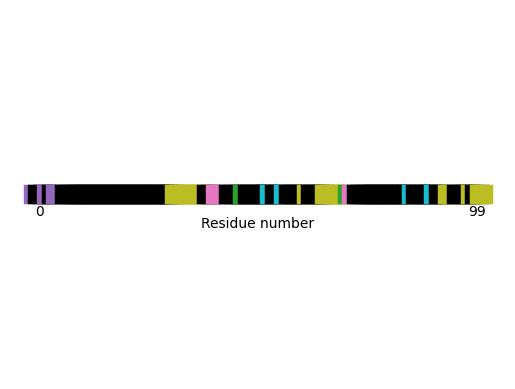

In [96]:
visualizations.plot_residue_line_plus_noise(residue_items, result_hdbscan_2_2.labels_)

In [97]:
from sklearn.cluster import AffinityPropagation

In [98]:
clustering_aff = AffinityPropagation(random_state=5, affinity="precomputed").fit(normed_similarity_matrix.astype(np.float64))
clustering_aff_1std = AffinityPropagation(random_state=5, affinity="precomputed").fit(normed_similarity_matrix_1std.astype(np.float64))
clustering_aff_2std = AffinityPropagation(random_state=5, affinity="precomputed").fit(normed_similarity_matrix_2std.astype(np.float64))

In [99]:
clustering.labels_

array([ 1, -1, -1,  1, -1,  1,  1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
       -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,  3,  3,  3,
        3,  3,  3,  3, -1, -1,  2,  2,  2, -1, -1, -1,  0, -1, -1, -1, -1,
       -1,  4, -1, -1,  4, -1, -1, -1, -1,  3, -1, -1, -1,  3,  3,  3,  3,
        3,  0,  2, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,  4, -1,
       -1, -1, -1,  4, -1, -1,  3,  3, -1, -1, -1,  3, -1,  3,  3])

In [100]:
clustering_aff_1std.labels_

array([ 0,  0,  0,  1,  1,  1,  2,  2,  2,  2,  3,  3,  3,  3,  3,  4,  4,
        4,  4,  4,  5,  5,  5,  5,  5,  5,  6,  6,  6,  6,  6,  6,  7,  7,
        7,  7,  7,  7,  7,  7,  8,  8,  8,  8,  9,  9,  9,  9,  9,  9, 10,
       10, 10, 10, 10, 11, 11, 11, 11, 11, 11, 11, 11, 12, 12, 12, 12, 12,
       12, 12, 13, 13, 13, 13, 13, 14, 14, 14, 14, 14, 14, 14, 14, 15, 15,
       15, 15, 15, 15, 16, 16, 16, 16, 16, 17, 17, 17, 18, 18, 18])

In [101]:
clustering_aff_2std.labels_

array([ 0,  0,  0,  1,  1,  1,  2,  2,  2,  2,  3,  3,  3,  3,  3,  4,  4,
        4,  4,  4,  5,  5,  5,  5,  5,  5,  6,  6,  6,  6,  6,  6,  7,  7,
        7,  7,  7,  7,  7,  7,  8,  8,  8,  8,  9,  9,  9,  9,  9,  9, 10,
       10, 10, 10, 10, 11, 11, 11, 11, 11, 11, 11, 11, 12, 12, 12, 12, 12,
       12, 12, 13, 13, 13, 13, 13, 14, 14, 14, 14, 14, 14, 14, 14, 15, 15,
       15, 15, 15, 15, 16, 16, 16, 16, 16, 17, 17, 17, 18, 18, 18])

In [102]:
res_hdbscan_2_1 = redpandda_general.main_clustering_general(df, None, clustering_algorithm="hdbscan", min_cluster_size=2, min_samples=1)

0.0043
something wrong with clustering Q computation


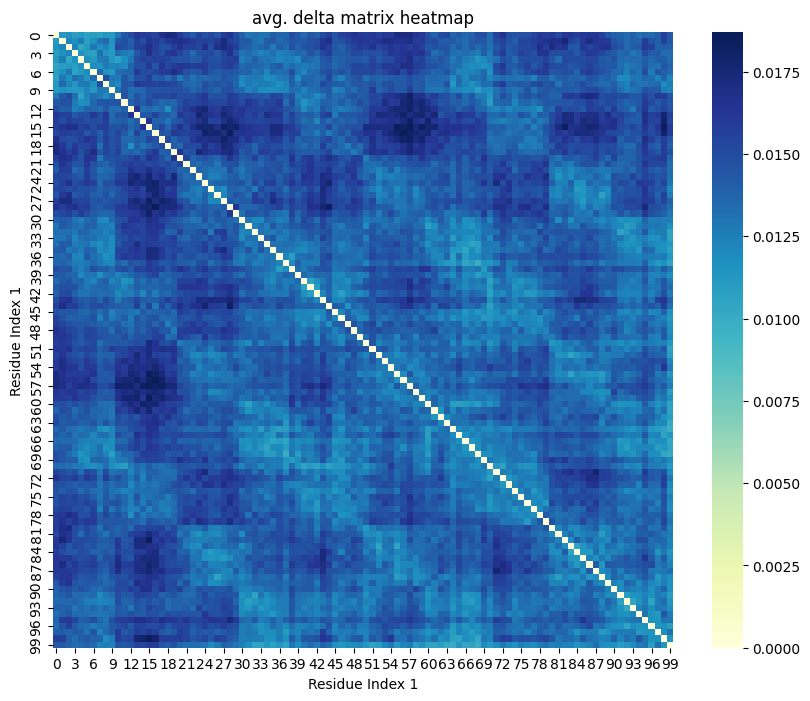

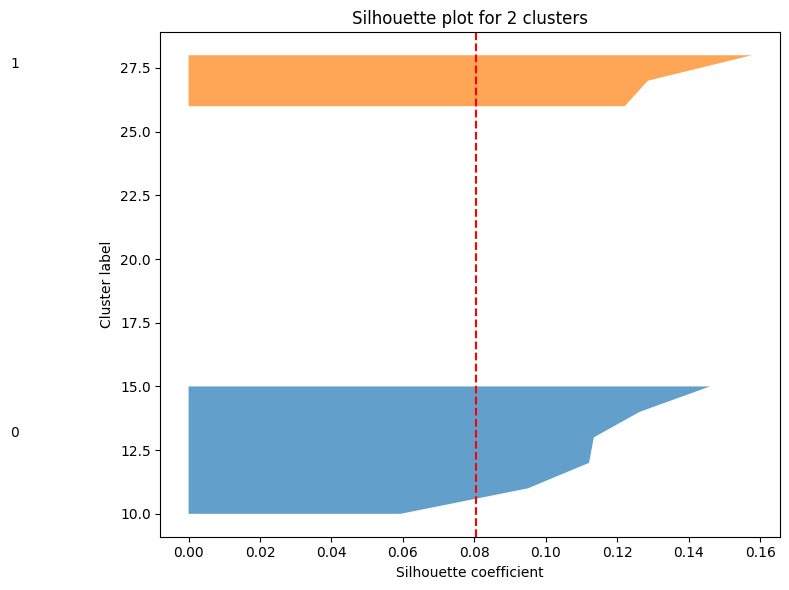

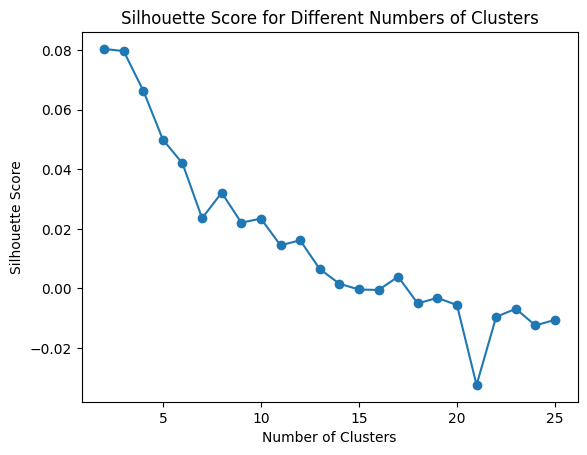

1.0798


In [103]:
spectral_opt_sil = distance_matrix.spectral_clustering_on_deltas(summed_delta_matrix, cluster_count=None, silhouette = True)
spectral_opt_sil = list(spectral_opt_sil)


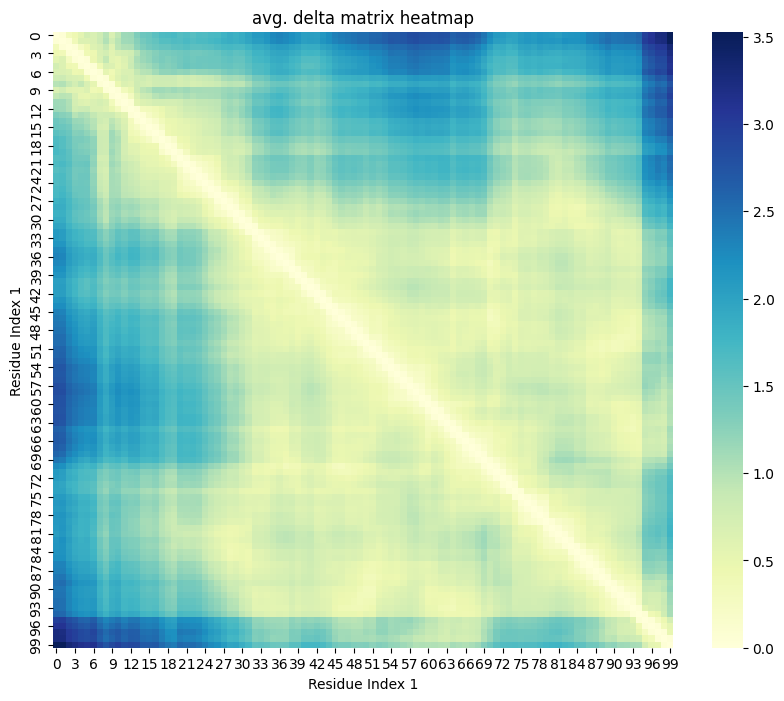

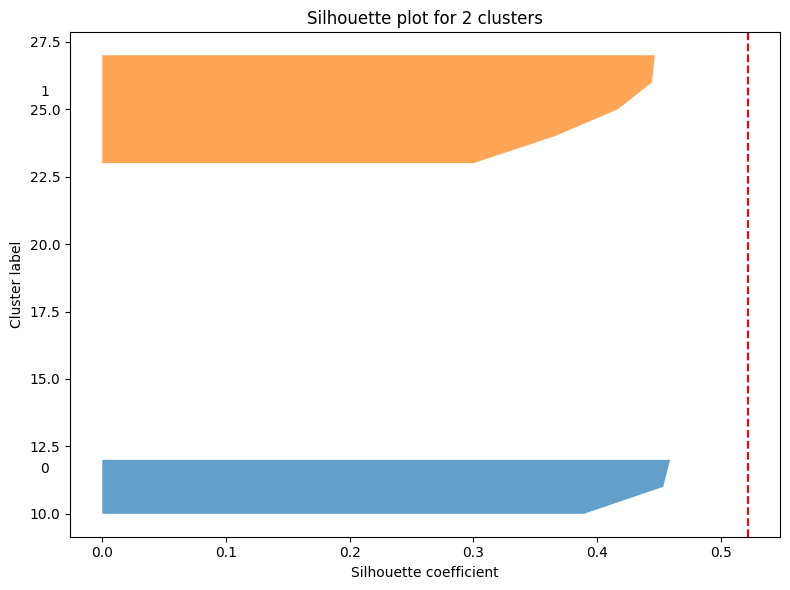

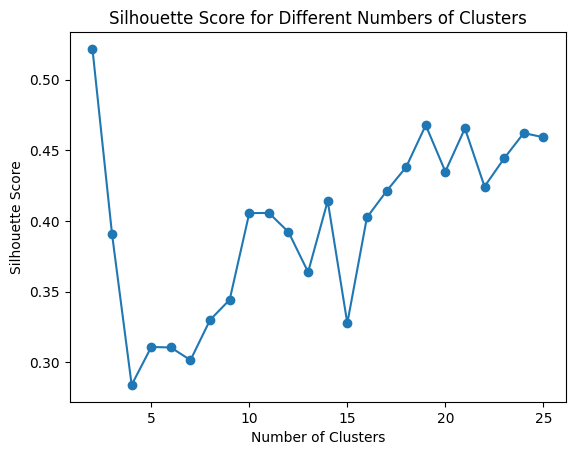

1.0283


In [104]:
spectral_opt_sil_1std = distance_matrix.spectral_clustering_on_deltas(summed_delta_matrix_1std, cluster_count=None, silhouette = True)
spectral_opt_sil_1std = list(spectral_opt_sil_1std)

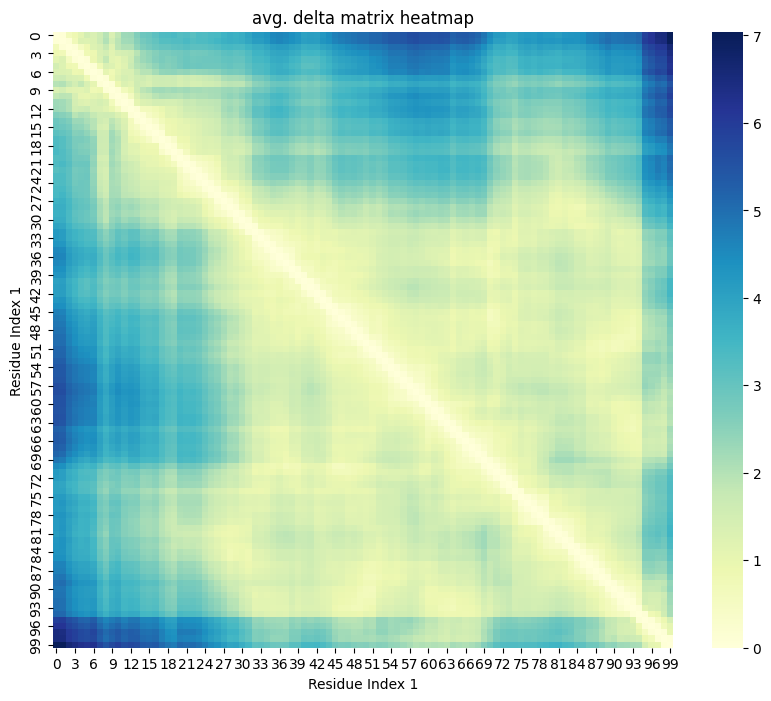

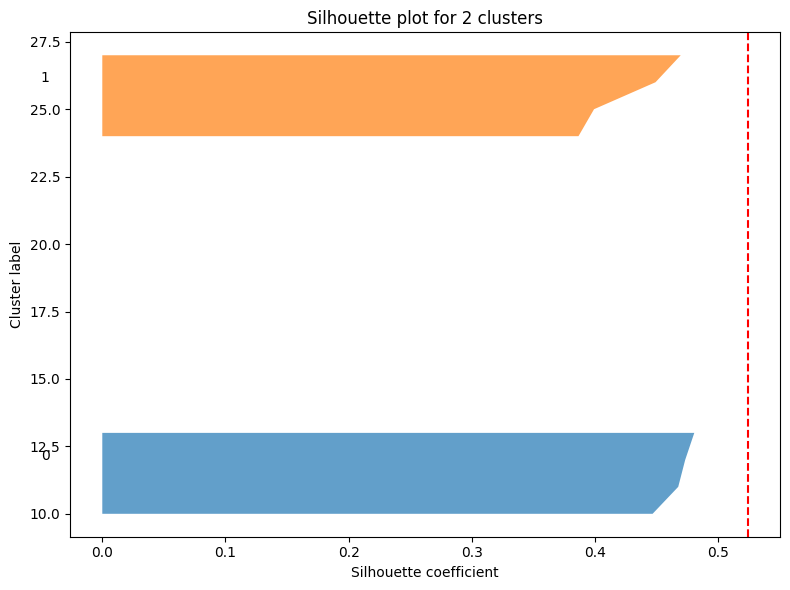

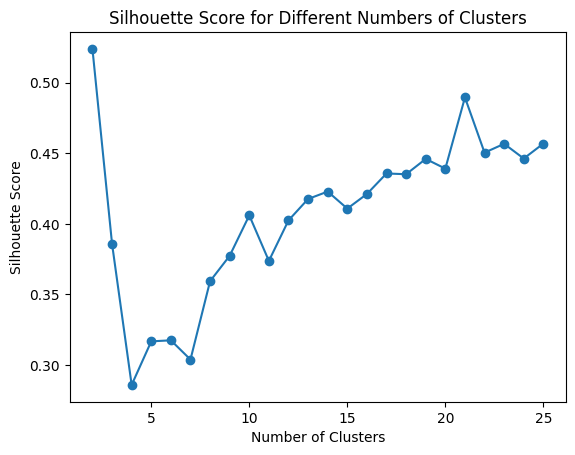

1.0262


In [105]:
spectral_opt_sil_2std = distance_matrix.spectral_clustering_on_deltas(summed_delta_matrix_2std, cluster_count=None, silhouette = True)
spectral_opt_sil_2std = list(spectral_opt_sil_2std)

In [106]:
clustering_names = []
clustering_results = []

clustering_names.append("hdbscan, min_cluster:2, min_samples:1")
clustering_results.append(list(res_hdbscan_2_1[0]))
clustering_names.append("hdbscan, +2std, min_cluster:2, min_samples:1")
clustering_results.append(list(res_hdbscan_2std[0]))

clustering_names.append("hdbscan, min_cluster:2, min_samples:2")
clustering_results.append(list(result_hdbscan_2_2.labels_))
clustering_names.append("hdbscan, +2std, min_cluster:2, min_samples:2")
clustering_results.append(list(result_hdbscan_2_2_2std.labels_))
clustering_names.append("hdbscan, min_cluster:4, min_samples:2")
clustering_results.append(list(result_hdbscan_4_2.labels_))
clustering_names.append("hdbscan, +1std, min_cluster:4, min_samples:2")
clustering_results.append(list(result_hdbscan_4_2_1std.labels_))



clustering_names.append("spectral,  clusters:6")
clustering_results.append(list(result_spectral_6.labels_))
clustering_names.append("spectral,  clusters:3")
clustering_results.append(list(result_spectral_3.labels_))
clustering_names.append("spectral,  clusters:4")
clustering_results.append(list(result_spectral_4.labels_))

clustering_names.append("affinity prop")
clustering_results.append(list(clustering_aff.labels_))
clustering_names.append("affinity prop, +1std")
clustering_results.append(list(clustering_aff_1std.labels_))
clustering_names.append("affinity prop, +2std")
clustering_results.append(list(clustering_aff_2std.labels_))

clustering_names.append("spectra, opt.silh.")
clustering_results.append(list(spectral_opt_sil))
clustering_names.append("spectra, opt.silh., +1std")
clustering_results.append(list(spectral_opt_sil_1std))
clustering_names.append("spectra, opt.silh., +2std")
clustering_results.append(list(spectral_opt_sil_2std))





In [107]:
import numpy as np
from scipy.optimize import linear_sum_assignment
from sklearn.metrics import confusion_matrix

def evaluate_clustering_nr_wrong_elements(true_labels, predicted_labels):

    cm = confusion_matrix(true_labels, predicted_labels)
    
    # Hungarian / Munkres algorithm
    row_ind, col_ind = linear_sum_assignment(-cm)
    
    correctly_clustered = cm[row_ind, col_ind].sum()
    
    total_items = len(true_labels)
    wrongly_clustered = total_items - correctly_clustered
    
    return wrongly_clustered

In [108]:
traj_array = np.array(trajectories)[:,:,:-1]

In [109]:
flattened_array = traj_array.reshape(traj_array.shape[0], -1)

In [110]:
clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2) 


result_hdbscan_2_2_flat = clustering.fit(flattened_array.astype(np.float64))


In [111]:
result_hdbscan_2_2_flat.labels_


array([-1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  1,  1,  1,
        1,  1, -1, -1,  2,  2,  2,  2,  2,  2,  2,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3, -1])

In [112]:
clustering = SpectralClustering(n_clusters=3)
result_spectral_3_flat = clustering.fit(flattened_array)

In [113]:
result_spectral_3_flat.labels_

array([1, 2, 1, 2, 2, 2, 1, 1, 1, 0, 2, 0, 2, 2, 2, 1, 2, 1, 1, 1, 0, 0,
       1, 2, 2, 0, 0, 0, 2, 0, 2, 1, 1, 1, 2, 2, 1, 2, 1, 0, 0, 2, 2, 2,
       1, 2, 2, 2, 2, 2, 1, 1, 1, 2, 0, 0, 2, 1, 2, 1, 2, 2, 2, 2, 1, 1,
       2, 1, 2, 2, 1, 1, 2, 0, 2, 0, 2, 2, 0, 1, 2, 0, 2, 2, 2, 0, 2, 2,
       2, 1, 1, 2, 1, 2, 0, 1, 2, 1, 2, 1], dtype=int32)

In [114]:
#vels_to_cluster = process_data.simulation_to_array_velocities(particles_from_sim)

In [115]:
def compute_velocities(points, delta_t=1):

    velocities = []
    
    for point_series in points:
        point_velocities = []
        for i in range(1, len(point_series)):
            velocity = [(point_series[i][j] - point_series[i-1][j]) / delta_t for j in range(3)]
            point_velocities.append(velocity)
        
        #let's assume starting velocity is 0
        point_velocities.insert(0, [0.0, 0.0, 0.0])
        velocities.append(point_velocities)
    
    return velocities

    
try:
    vels_to_cluster = process_data.simulation_to_array_velocities(particles_from_sim)
    traj_array_vel = np.array(vels_to_cluster)[:,:,:-1]
    flattened_array_vel = traj_array_vel.reshape(traj_array_vel.shape[0], -1)

except:
    print("no simulation data with velocities")
    traj_array_vel = compute_velocities(traj_array)
    traj_array_vel = np.array(traj_array_vel)
    flattened_array_vel =  traj_array_vel.reshape(traj_array_vel.shape[0], -1)

In [116]:
traj_array = np.array(trajectories)[:,:,:-1]
flattened_array = traj_array.reshape(traj_array.shape[0], -1)

In [117]:
#traj_array_vel = np.array(vels_to_cluster)[:,:,:-1]
#flattened_array_vel = traj_array_vel.reshape(traj_array_vel.shape[0], -1)

In [118]:
clustering = SpectralClustering(n_clusters=3)
result_spectral_3_flat = clustering.fit(flattened_array)
result_spectral_3_flat.labels_

array([0, 0, 0, 2, 1, 0, 0, 0, 2, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1,
       0, 0, 1, 2, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 2, 0,
       1, 1, 2, 1, 1, 0, 2, 1, 1, 2, 0, 2, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1,
       0, 0, 2, 0, 2, 1, 1, 0, 2, 0, 0, 2, 2, 1, 0, 0, 1, 2, 1, 1, 0, 1,
       1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0], dtype=int32)

In [119]:
clustering = SpectralClustering(n_clusters=4)
result_spectral_4_flat = clustering.fit(flattened_array)
result_spectral_4_flat.labels_

array([0, 2, 0, 3, 0, 0, 0, 0, 2, 2, 0, 3, 0, 3, 1, 1, 1, 2, 0, 2, 0, 3,
       0, 3, 2, 0, 3, 0, 1, 0, 2, 1, 3, 3, 2, 0, 0, 0, 0, 0, 3, 3, 0, 3,
       0, 1, 0, 0, 0, 1, 1, 3, 0, 0, 0, 1, 0, 3, 0, 3, 3, 0, 3, 1, 2, 3,
       0, 0, 3, 2, 0, 3, 0, 1, 3, 1, 1, 1, 0, 0, 3, 0, 2, 0, 1, 3, 0, 3,
       3, 2, 3, 0, 3, 2, 1, 1, 1, 0, 0, 0], dtype=int32)

In [120]:
clustering = SpectralClustering(n_clusters=3)
result_spectral_3_flat_vel = clustering.fit(flattened_array_vel)
result_spectral_3_flat_vel.labels_

array([2, 2, 0, 1, 2, 1, 0, 0, 1, 2, 0, 2, 0, 0, 2, 0, 2, 0, 1, 0, 1, 0,
       0, 0, 2, 2, 0, 0, 2, 1, 2, 2, 0, 0, 1, 1, 2, 0, 0, 0, 0, 0, 2, 0,
       2, 0, 1, 0, 1, 0, 1, 0, 2, 1, 0, 0, 2, 1, 0, 0, 1, 2, 2, 1, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 1, 2, 0, 2, 0, 2, 0, 1, 0, 0, 0, 0,
       1, 1, 0, 0, 0, 2, 0, 0, 0, 1, 2, 0], dtype=int32)

In [121]:
clustering = SpectralClustering(n_clusters=4)
result_spectral_4_flat_vel = clustering.fit(flattened_array_vel)
result_spectral_4_flat_vel.labels_

array([2, 1, 0, 0, 0, 1, 2, 3, 1, 2, 0, 0, 0, 1, 3, 0, 0, 1, 0, 1, 2, 0,
       0, 2, 3, 3, 1, 1, 0, 0, 1, 1, 3, 0, 0, 0, 0, 1, 1, 0, 2, 3, 3, 0,
       1, 1, 2, 1, 1, 0, 0, 1, 0, 0, 1, 0, 2, 1, 3, 3, 1, 0, 1, 0, 1, 3,
       3, 1, 2, 0, 2, 1, 0, 3, 0, 3, 2, 1, 3, 3, 1, 1, 3, 1, 2, 1, 1, 3,
       0, 0, 1, 0, 1, 1, 3, 0, 3, 3, 3, 2], dtype=int32)

In [122]:
clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2) 


result_hdbscan_2_2_flat = clustering.fit(flattened_array.astype(np.float64))
result_hdbscan_2_2_flat.labels_

array([-1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  1,  1,  1,
        1,  1, -1, -1,  2,  2,  2,  2,  2,  2,  2,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3, -1])

In [123]:
clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=1) 


result_hdbscan_2_1_flat_vel = clustering.fit(flattened_array_vel.astype(np.float64))
result_hdbscan_2_1_flat_vel.labels_

array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, -1, -1,  0,  0,  0,
        0,  0, -1, -1, -1,  1,  1,  1,  1,  1,  1,  1, -1,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, -1,
        2,  1,  1, -1,  1,  1,  1,  1,  1,  0,  0,  0, -1,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  1,  2, -1,  1,  1,
        1,  1,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])

In [124]:
clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2) 


result_hdbscan_2_2_flat_vel = clustering.fit(flattened_array_vel.astype(np.float64))
result_hdbscan_2_2_flat_vel.labels_

array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, -1, -1,  0, -1, -1,
       -1,  0, -1, -1, -1, -1,  1,  1,  1,  1,  1,  1, -1,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, -1, -1,
        1,  1,  1, -1,  1,  1,  1,  1,  1,  0,  0,  0, -1,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, -1,  1, -1, -1,  1,  1,
        1,  1,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])

In [125]:
clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2) 


result_hdbscan_2_2_flat = clustering.fit(flattened_array.astype(np.float64))
result_hdbscan_2_2_flat.labels_

clustering_names.append("hdbscan, flattened positions, 2, 2")
clustering_results.append(list(result_hdbscan_2_2_flat.labels_))

In [126]:
clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2) 


result_hdbscan_2_2_flat_vel = clustering.fit(flattened_array_vel.astype(np.float64))
result_hdbscan_2_2_flat_vel.labels_

clustering_names.append("hdbscan, flattened velocities, 2, 2")
clustering_results.append(list(result_hdbscan_2_2_flat_vel.labels_))

In [127]:

clustering_names.append("ground truth")
clustering_results.append(list(true_labels))

In [128]:
result_hdbscan_2_2.labels_

array([ 1, -1, -1,  1, -1,  1,  1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
       -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,  3,  3,  3,
        3,  3,  3,  3, -1, -1,  2,  2,  2, -1, -1, -1,  0, -1, -1, -1, -1,
       -1,  4, -1, -1,  4, -1, -1, -1, -1,  3, -1, -1, -1,  3,  3,  3,  3,
        3,  0,  2, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,  4, -1,
       -1, -1, -1,  4, -1, -1,  3,  3, -1, -1, -1,  3, -1,  3,  3])

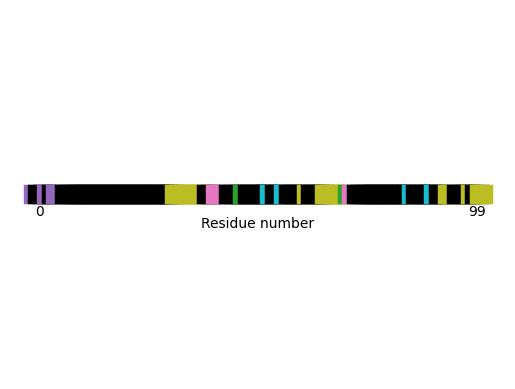

In [129]:
visualizations.plot_residue_line_plus_noise(residue_items, result_hdbscan_2_2.labels_)

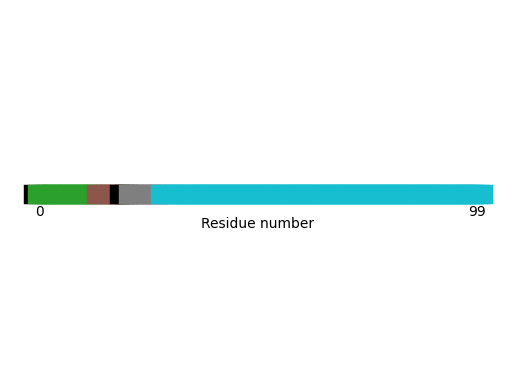

In [130]:
visualizations.plot_residue_line_plus_noise(residue_items, result_hdbscan_2_2_flat.labels_)

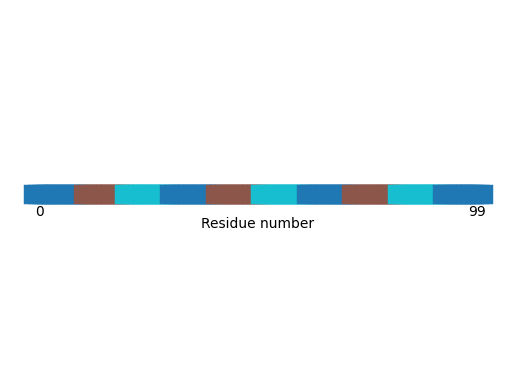

In [131]:
visualizations.plot_residue_line_plus_noise(residue_items, result_spectral_3.labels_)

In [132]:
import sklearn 
def get_clustering_similarity_true(true_clustering, clusterings, sim_function = sklearn.metrics.adjusted_rand_score):
    sim_results = []
    for i in range(len(clusterings)):
        sim_result = sim_function(true_clustering, clusterings[i])
        sim_results.append(sim_result)
    return sim_results

def get_clustering_similarity_true_trajectories(true_clusterings, clusterings, sim_function = sklearn.metrics.adjusted_rand_score):
    sim_results = []
    for i in range(len(clusterings)):
        sim_result = sim_function(true_clusterings[i], clusterings[i])
        sim_results.append(sim_result)
    return sim_result



Text(0.5, 1.0, 'adjusted rand score')

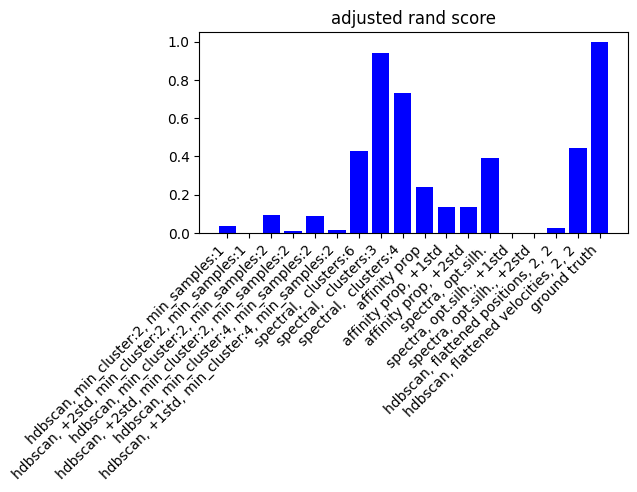

In [133]:
sim_scores = get_clustering_similarity_true(true_labels, clustering_results)
plt.bar(clustering_names, sim_scores, color='blue')
plt.xticks(rotation=45, ha='right')  

plt.tight_layout()

plt.title("adjusted rand score")

Text(0.5, 1.0, 'nr. of wrong elements')

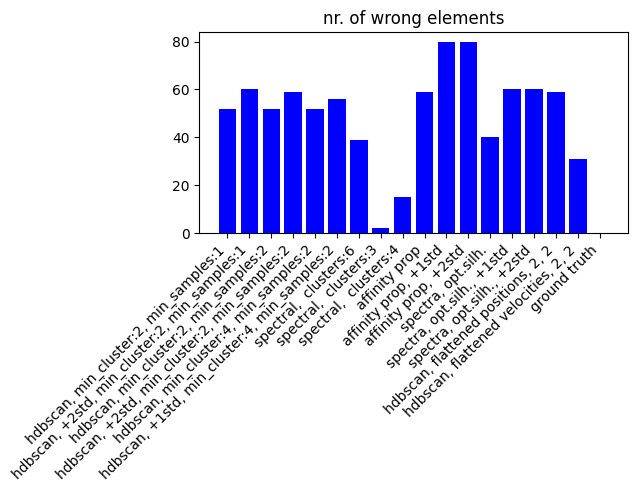

In [134]:
sim_scores = get_clustering_similarity_true(true_labels, clustering_results, evaluate_clustering_nr_wrong_elements)
plt.bar(clustering_names, sim_scores, color='blue')
plt.xticks(rotation=45, ha='right')  

plt.tight_layout()

plt.title("nr. of wrong elements")

Text(0.5, 1.0, 'NMI')

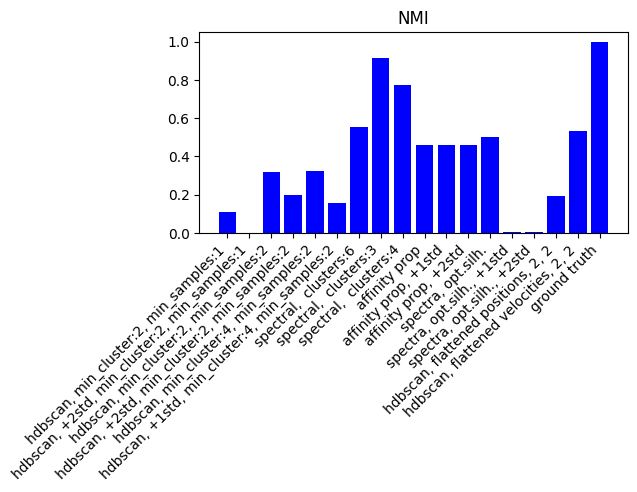

In [135]:
sim_scores = get_clustering_similarity_true(true_labels, clustering_results, sklearn.metrics.normalized_mutual_info_score)
plt.bar(clustering_names, sim_scores, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("NMI")

Text(0.5, 1.0, 'number of points class. as noise')

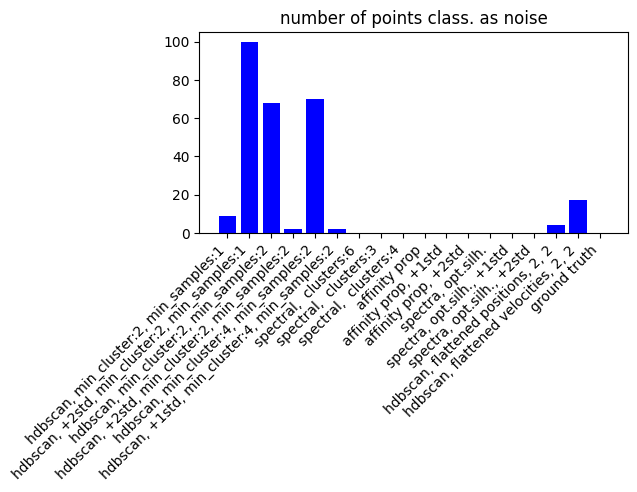

In [136]:
noise_elements = []
noise_int = -1
for res in clustering_results:
    noise_el = len(np.where(np.array(res)==noise_int)[0])
    noise_elements.append(noise_el)

plt.bar(clustering_names, noise_elements, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("number of points class. as noise")

Text(0.5, 1.0, 'number of clusters')

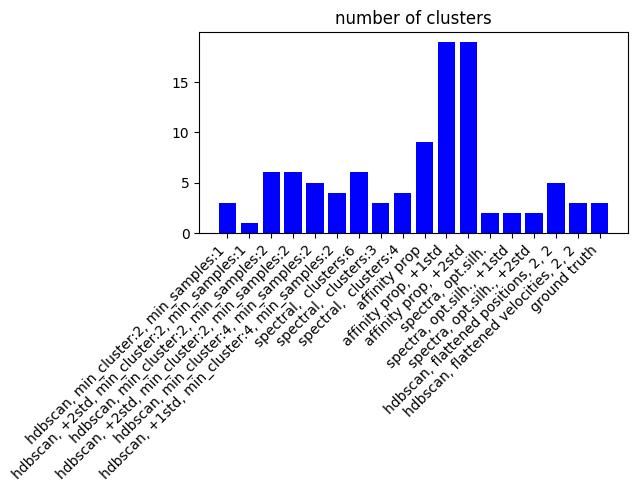

In [137]:

plt.bar(clustering_names, [len(np.unique(x)) for x in clustering_results], color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("number of clusters")

In [138]:
#Q calculations

clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise


Text(0.5, 1.0, 'Q_max from distance matrices, full, thinning=500')

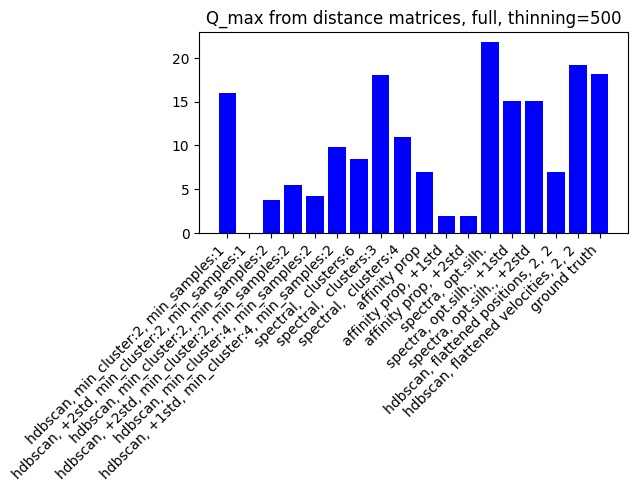

In [139]:
Qs = []
for res in clustering_results:

    new_dist_Q_max_value, _ = get_Q_for_clustering_extended(dist_matrices, np.array(res), None, use_max=True, thinning_factor=500, only_adjacent=False, reference_frame=None, return_raw=False)
    Qs.append(new_dist_Q_max_value)

plt.bar(clustering_names, Qs, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("Q_max from distance matrices, full, thinning=500")

In [140]:
'''
Qs = []
for res in clustering_results:

    new_dist_Q_max_value, _ = get_Q_for_clustering_extended(dist_matrices, np.array(res), None, use_max=True, thinning_factor=None, only_adjacent=False, reference_frame=None, return_raw=False)
    Qs.append(new_dist_Q_max_value)

plt.bar(clustering_names, Qs, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("Q_max from distance matrices, full")
'''

'\nQs = []\nfor res in clustering_results:\n\n    new_dist_Q_max_value, _ = get_Q_for_clustering_extended(dist_matrices, np.array(res), None, use_max=True, thinning_factor=None, only_adjacent=False, reference_frame=None, return_raw=False)\n    Qs.append(new_dist_Q_max_value)\n\nplt.bar(clustering_names, Qs, color=\'blue\')\nplt.xticks(rotation=45, ha=\'right\') \n\nplt.tight_layout()\n\nplt.title("Q_max from distance matrices, full")\n'

clustering contains noise


clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise


Text(0.5, 1.0, 'Q_mean from distance matrices, full, thinning 500')

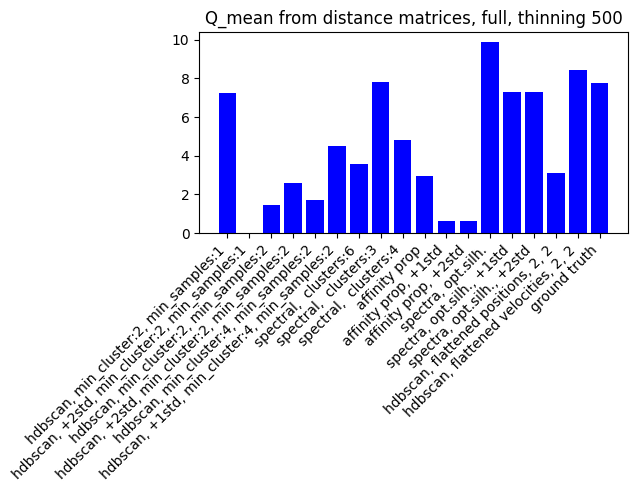

In [141]:
Qsf3= []
for res in clustering_results:

    new_dist_Q_max_value, _ = get_Q_for_clustering_extended(dist_matrices, np.array(res), None, use_max=False, thinning_factor=500, only_adjacent=False, reference_frame=None, return_raw=False)
    Qsf3.append(new_dist_Q_max_value)

plt.bar(clustering_names, Qsf3, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("Q_mean from distance matrices, full, thinning 500")

In [142]:
'''
Qsf3= []
for res in clustering_results:

    new_dist_Q_max_value, _ = get_Q_for_clustering_extended(dist_matrices, np.array(res), None, use_max=False, thinning_factor=None, only_adjacent=False, reference_frame=None, return_raw=False)
    Qsf3.append(new_dist_Q_max_value)

plt.bar(clustering_names, Qsf3, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("Q_mean from distance matrices, full")
'''

'\nQsf3= []\nfor res in clustering_results:\n\n    new_dist_Q_max_value, _ = get_Q_for_clustering_extended(dist_matrices, np.array(res), None, use_max=False, thinning_factor=None, only_adjacent=False, reference_frame=None, return_raw=False)\n    Qsf3.append(new_dist_Q_max_value)\n\nplt.bar(clustering_names, Qsf3, color=\'blue\')\nplt.xticks(rotation=45, ha=\'right\') \n\nplt.tight_layout()\n\nplt.title("Q_mean from distance matrices, full")\n'

clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise


Text(0.5, 1.0, 'Q_max from positions, Kabsch superimposition, full, thinning=100')

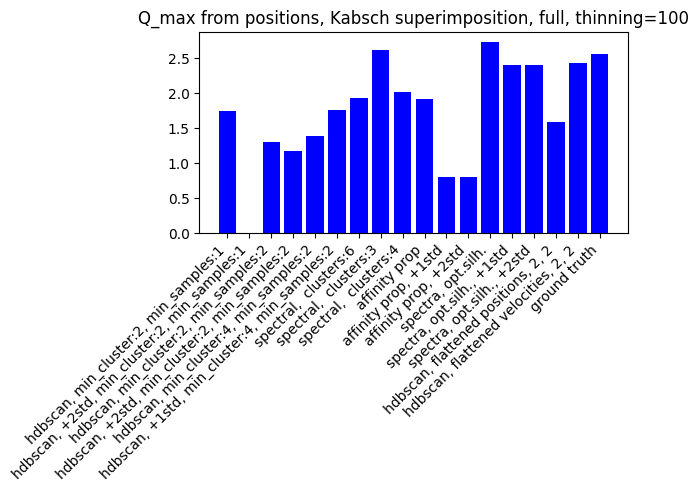

In [143]:

Qs = []

for res in clustering_results:


    new_dist_Q_max_value, _ = get_Q_for_clustering_positions(traj_array, np.array(res), None, use_max=True, apply_superimposition = "kabsch", thinning_factor=100, only_adjacent=False, reference_frame=None, return_raw=False)
    Qs.append(new_dist_Q_max_value)

plt.bar(clustering_names, Qs, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("Q_max from positions, Kabsch superimposition, full, thinning=100")

clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise


Text(0.5, 1.0, 'Q_mean from positions, Kabsch superimposition, full, thinning 50')

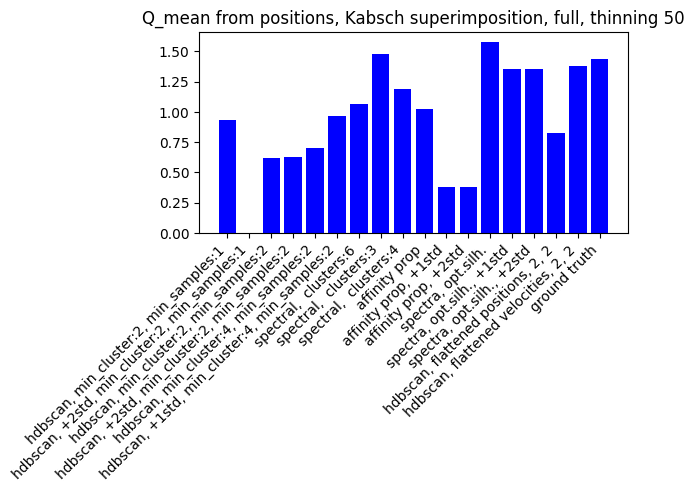

In [144]:
Qs = []

for res in clustering_results:


    new_dist_Q_max_value, _ = get_Q_for_clustering_positions(traj_array, np.array(res), None, use_max=False, apply_superimposition = "kabsch", thinning_factor=50, only_adjacent=False, reference_frame=None, return_raw=False)
    Qs.append(new_dist_Q_max_value)

plt.bar(clustering_names, Qs, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("Q_mean from positions, Kabsch superimposition, full, thinning 50")

In [145]:
#q computation fuer verschiedene cluster

In [146]:
import compare_clusterings
import numpy as np
from itertools import combinations

In [147]:
from compare_clusterings import *
from manipulate_trajectory import thin_trajectory

In [148]:
clustering_results

[[0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  -1,
  -1,
  -1,
  -1,
  -1,
  0,
  -1,
  -1,
  -1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  -1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0],
 [-1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1

In [149]:
clustering_names

['hdbscan, min_cluster:2, min_samples:1',
 'hdbscan, +2std, min_cluster:2, min_samples:1',
 'hdbscan, min_cluster:2, min_samples:2',
 'hdbscan, +2std, min_cluster:2, min_samples:2',
 'hdbscan, min_cluster:4, min_samples:2',
 'hdbscan, +1std, min_cluster:4, min_samples:2',
 'spectral,  clusters:6',
 'spectral,  clusters:3',
 'spectral,  clusters:4',
 'affinity prop',
 'affinity prop, +1std',
 'affinity prop, +2std',
 'spectra, opt.silh.',
 'spectra, opt.silh., +1std',
 'spectra, opt.silh., +2std',
 'hdbscan, flattened positions, 2, 2',
 'hdbscan, flattened velocities, 2, 2',
 'ground truth']

clustering contains noise


clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise


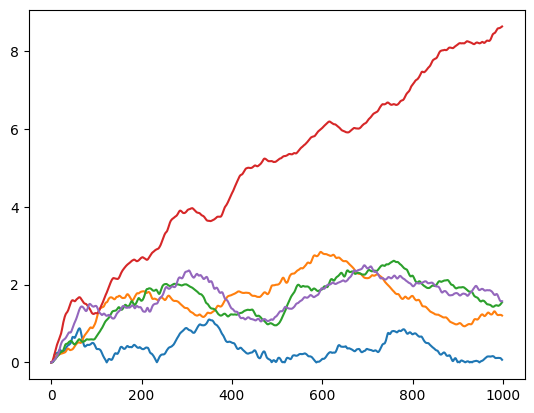

In [150]:
current_clustering = np.array(clustering_results[clustering_names.index('hdbscan, min_cluster:2, min_samples:2')])
qtraj_nosup = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=False, apply_superimposition = None, thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_center = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=True, apply_superimposition = None, thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_kabsch = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=True, apply_superimposition = "kabsch", thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_procrustes = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=True, apply_superimposition = "procrustes", thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_dist = get_Q_for_clustering_extended(dist_matrices, current_clustering, None, use_max=True, thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_dist_adj = get_Q_for_clustering_extended(dist_matrices, current_clustering, None, use_max=True, thinning_factor=None, only_adjacent=True,  return_raw=True)

for qt in qtraj_dist:
    plt.plot(qt)

In [151]:
current_clustering = np.array(clustering_results[clustering_names.index('ground truth')])

In [152]:
qtraj_nosup = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=False, apply_superimposition = None, thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_center = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=True, apply_superimposition = None, thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_kabsch = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=True, apply_superimposition = "kabsch", thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_procrustes = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=True, apply_superimposition = "procrustes", thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_dist = get_Q_for_clustering_extended(dist_matrices, current_clustering, None, use_max=True, thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_dist_adj = get_Q_for_clustering_extended(dist_matrices, current_clustering, None, use_max=True, thinning_factor=None, only_adjacent=True,  return_raw=True)



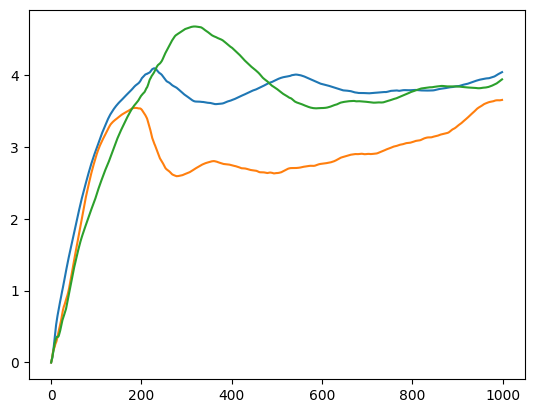

In [153]:
for qt in qtraj_nosup:
    plt.plot(qt)

Text(0.5, 1.0, 'RMSD from positions, centered, reference_frame=0')

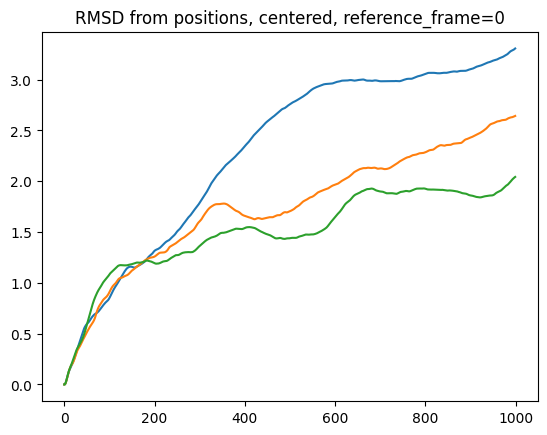

In [154]:
%matplotlib inline
for qt in qtraj_center:
    plt.plot(qt)
plt.title("RMSD from positions, centered, reference_frame=0")

Text(0.5, 1.0, 'RMSD from positions, Kabsch, reference_frame=0')

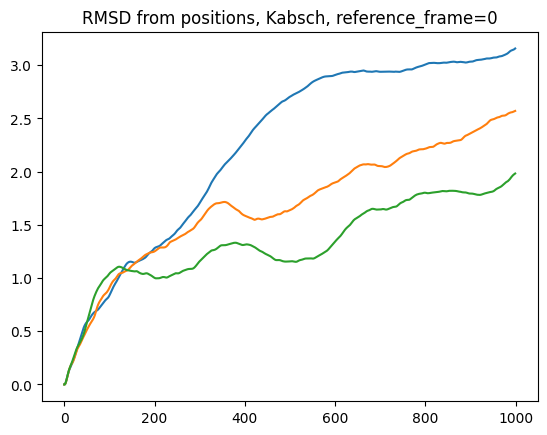

In [155]:
for qt in qtraj_kabsch:
    plt.plot(qt)
plt.title("RMSD from positions, Kabsch, reference_frame=0")

Text(0.5, 1.0, 'RMSD from positions, Procrustes, reference_frame=0')

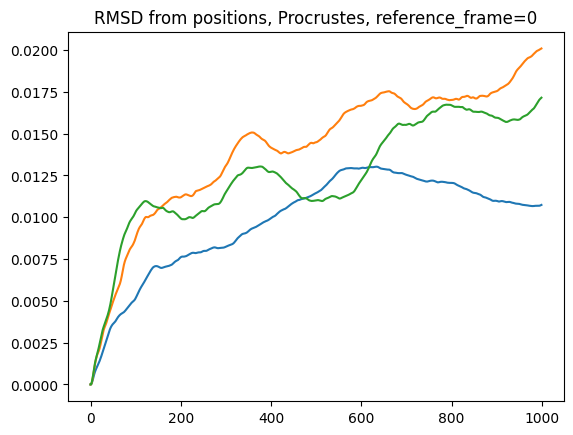

In [156]:
for qt in qtraj_procrustes:
    plt.plot(qt)
plt.title("RMSD from positions, Procrustes, reference_frame=0")

Text(0.5, 1.0, 'RMSD from distance matrices, reference_frame=0')

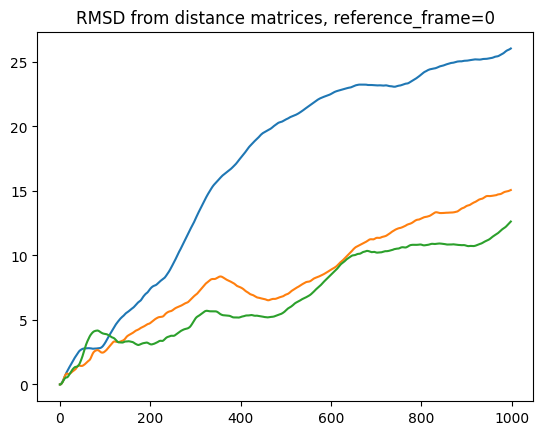

In [157]:
for qt in qtraj_dist:
    plt.plot(qt)
plt.title("RMSD from distance matrices, reference_frame=0")

Text(0.5, 1.0, 'RMSD from distance matrices, adjacent frames')

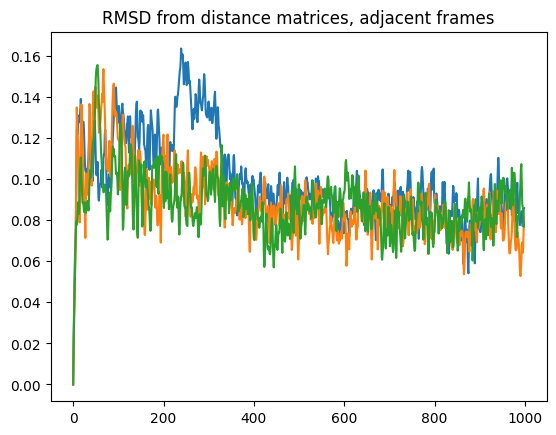

In [158]:
for qt in qtraj_dist_adj:
    plt.plot(qt)
plt.title("RMSD from distance matrices, adjacent frames")

In [159]:
clustering_results

[[0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  -1,
  -1,
  -1,
  -1,
  -1,
  0,
  -1,
  -1,
  -1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  -1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0],
 [-1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1

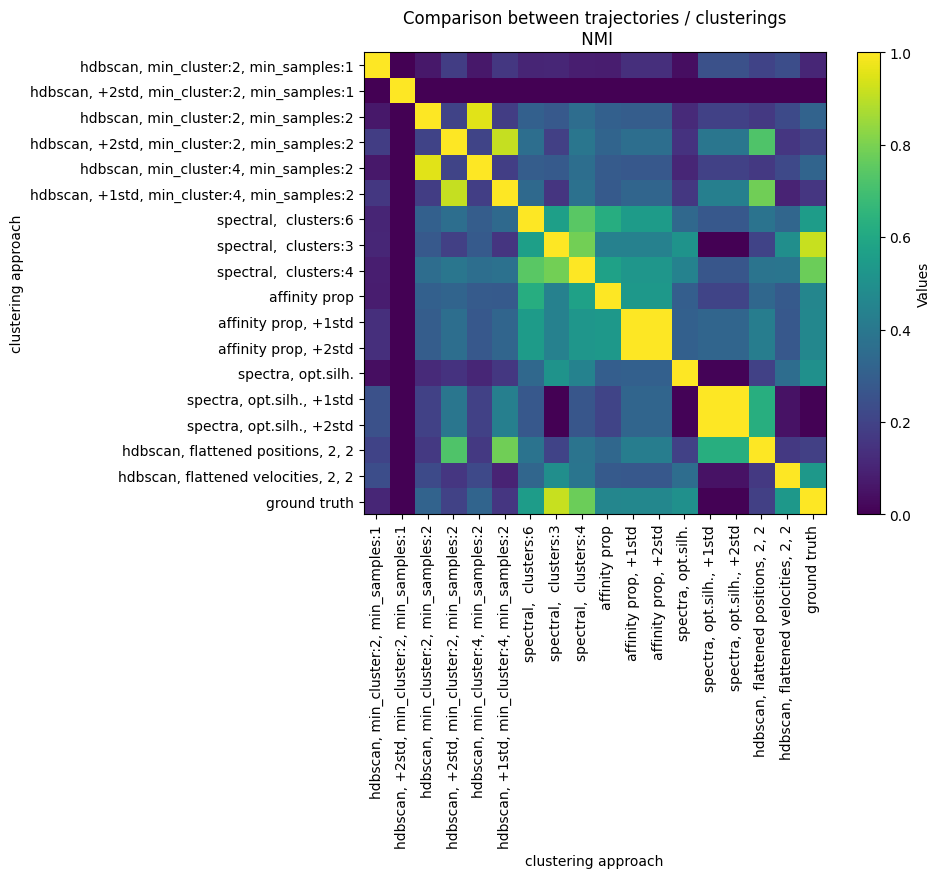

[[0, 0, 1.0],
 [0, 1, 0.0],
 [0, 2, 0.06353546372739453],
 [0, 3, 0.1805077840942634],
 [0, 4, 0.0626592995818569],
 [0, 5, 0.16273195415863895],
 [0, 6, 0.1046641877347684],
 [0, 7, 0.10787046612129984],
 [0, 8, 0.08336779815162115],
 [0, 9, 0.08137496556997069],
 [0, 10, 0.13336422741777676],
 [0, 11, 0.13336422741777676],
 [0, 12, 0.03534526893489567],
 [0, 13, 0.24683223256403541],
 [0, 14, 0.24683223256403541],
 [0, 15, 0.20205813201154524],
 [0, 16, 0.23683069474085436],
 [0, 17, 0.10719623837168281],
 [1, 0, 0.0],
 [1, 1, 1.0],
 [1, 2, 0.0],
 [1, 3, 0.0],
 [1, 4, 0.0],
 [1, 5, 0.0],
 [1, 6, 0.0],
 [1, 7, 0.0],
 [1, 8, 0.0],
 [1, 9, 0.0],
 [1, 10, 0.0],
 [1, 11, 0.0],
 [1, 12, 0.0],
 [1, 13, 0.0],
 [1, 14, 0.0],
 [1, 15, 0.0],
 [1, 16, 0.0],
 [1, 17, 0.0],
 [2, 0, 0.06353546372739453],
 [2, 1, 0.0],
 [2, 2, 1.0],
 [2, 3, 0.2012343057362202],
 [2, 4, 0.9541325650215217],
 [2, 5, 0.18319743331291813],
 [2, 6, 0.30750371736720183],
 [2, 7, 0.2795900131018563],
 [2, 8, 0.357545459292

In [160]:
%matplotlib inline
get_trajectory_heatmap(np.array(clustering_results), np.array(clustering_results), nmi = True, create_heatmap = True, title = "Comparison between trajectories / clusterings", names=clustering_names, heatmap_label="clustering approach")

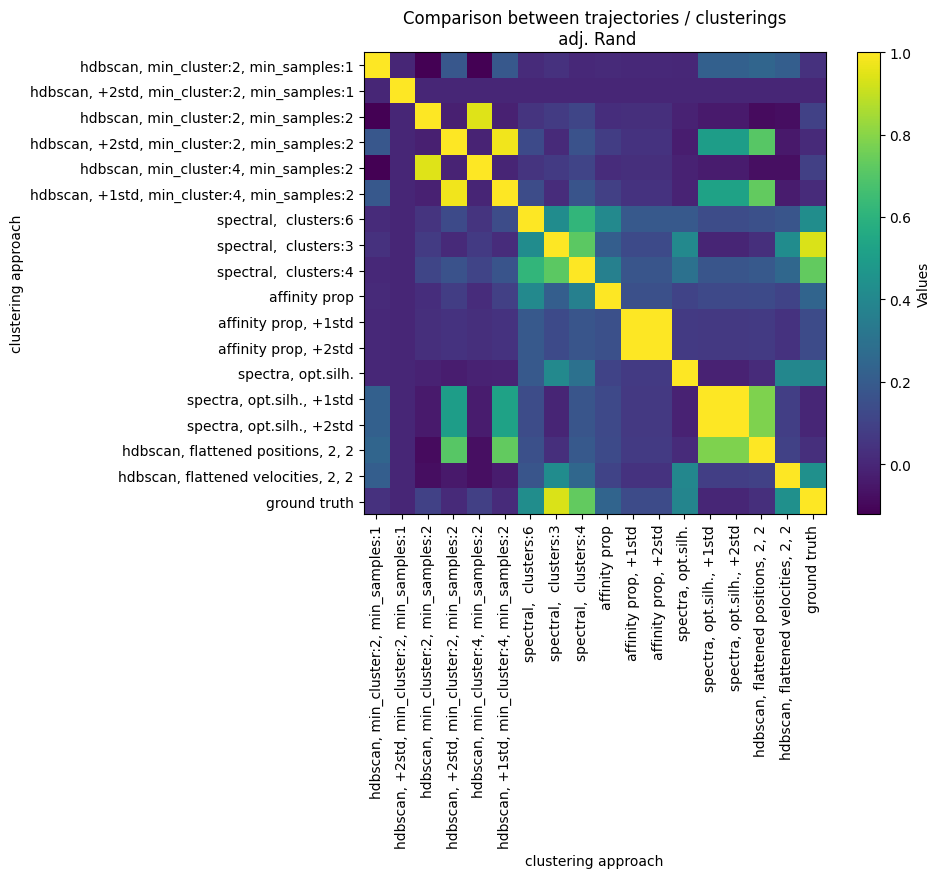

[[0, 0, 1.0],
 [0, 1, 0.0],
 [0, 2, -0.12171859977363358],
 [0, 3, 0.1829114072941256],
 [0, 4, -0.12134527717293121],
 [0, 5, 0.18521021034584303],
 [0, 6, 0.017231168725084827],
 [0, 7, 0.03945626994877236],
 [0, 8, 0.0059104489793090015],
 [0, 9, 0.013010857933323539],
 [0, 10, 0.007420974201290651],
 [0, 11, 0.007420974201290651],
 [0, 12, 0.004734019024444894],
 [0, 13, 0.2212559736151309],
 [0, 14, 0.2212559736151309],
 [0, 15, 0.2430281734592968],
 [0, 16, 0.21318091966216218],
 [0, 17, 0.038638661125463325],
 [1, 0, 0.0],
 [1, 1, 1.0],
 [1, 2, 0.0],
 [1, 3, 0.0],
 [1, 4, 0.0],
 [1, 5, 0.0],
 [1, 6, 0.0],
 [1, 7, 0.0],
 [1, 8, 0.0],
 [1, 9, 0.0],
 [1, 10, 0.0],
 [1, 11, 0.0],
 [1, 12, 0.0],
 [1, 13, 0.0],
 [1, 14, 0.0],
 [1, 15, 0.0],
 [1, 16, 0.0],
 [1, 17, 0.0],
 [2, 0, -0.12171859977363358],
 [2, 1, 0.0],
 [2, 2, 1.0],
 [2, 3, -0.022844632894806448],
 [2, 4, 0.9450753867241042],
 [2, 5, -0.018600563875361575],
 [2, 6, 0.04863985807214666],
 [2, 7, 0.07365244204569187],
 [2, 8

In [161]:
get_trajectory_heatmap(np.array(clustering_results), np.array(clustering_results), nmi = False, create_heatmap = True, title = "Comparison between trajectories / clusterings", names=clustering_names, heatmap_label="clustering approach")

In [162]:
clustering_results

[[0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  -1,
  -1,
  -1,
  -1,
  -1,
  0,
  -1,
  -1,
  -1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  -1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0],
 [-1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1

In [163]:
clustering_names

['hdbscan, min_cluster:2, min_samples:1',
 'hdbscan, +2std, min_cluster:2, min_samples:1',
 'hdbscan, min_cluster:2, min_samples:2',
 'hdbscan, +2std, min_cluster:2, min_samples:2',
 'hdbscan, min_cluster:4, min_samples:2',
 'hdbscan, +1std, min_cluster:4, min_samples:2',
 'spectral,  clusters:6',
 'spectral,  clusters:3',
 'spectral,  clusters:4',
 'affinity prop',
 'affinity prop, +1std',
 'affinity prop, +2std',
 'spectra, opt.silh.',
 'spectra, opt.silh., +1std',
 'spectra, opt.silh., +2std',
 'hdbscan, flattened positions, 2, 2',
 'hdbscan, flattened velocities, 2, 2',
 'ground truth']

In [164]:

new_plot_data = process_data.prepare_clustered_results_for_plotly(trajectories, np.array(clustering_results[clustering_names.index('hdbscan, min_cluster:2, min_samples:2')]))

In [165]:
%matplotlib notebook

ab_hsv = plot_functions.plot_traj_labels_plt(new_plot_data, save_video=False, interval = 10, color_map='Spectral', noise_label = -1, title = sim_command + "\n hdbscan, min_cluster:2, min_samples:2", plt_fig_size=(10,7.5))

<IPython.core.display.Javascript object>

In [166]:
from IPython.display import HTML
HTML(ab_hsv.to_html5_video())

In [167]:
new_plot_data = process_data.prepare_clustered_results_for_plotly(trajectories, np.array(clustering_results[clustering_names.index('hdbscan, +2std, min_cluster:2, min_samples:2')]))
%matplotlib notebook

ab_hsv_2std = plot_functions.plot_traj_labels_plt(new_plot_data, save_video=False, interval = 10, color_map='Spectral', noise_label = -1, title = "\n hdbscan, +2std, min_cluster:2, min_samples:2")

from IPython.display import HTML
HTML(ab_hsv_2std.to_html5_video())

<IPython.core.display.Javascript object>